# Panfetal B1 
# 11 Aug 2021 Chenqu

In [1]:
import numpy as np
import scipy as sp
import scanpy as sc
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import rc
from matplotlib import colors
import seaborn as sb
from itertools import compress
import random
import scirpy as ir

sc.settings.set_figure_params(dpi = 160, color_map = 'RdYlBu_r', dpi_save = 300, format = 'pdf')
plt.rcParams["figure.figsize"] = [6,6]
#plt.rcParams['font.sans-serif']=['Arial']
#rc('font', **{'family':'sans-serif', 'sans-serif':['Arial']})
#plt.rcParams['pdf.fonttype'] = 'truetype'

In [2]:
sb.set_palette('tab10')

In [3]:
# import utils
import sys
sys.path.append('/home/jovyan/chenqu_utils')
from array_operations import *
sys.path.append('/home/jovyan/thymusatlas/')
import scjp
from scjp import model

In [4]:
organ_order = ['YS','LI','BM','TH','SP','MLN','SK','GU','KI']
organ_name_order = ['Yolk Sac','Liver','Bone Marrow','Thymus','Spleen','Mesenteric Lymph Node','Skin','Gut','Kidney']

In [5]:
# set working directory
%cd /home/jovyan/panfetal/

/home/jovyan/panfetal


In [6]:
# figure directory
fig_path = '/home/jovyan/mount/gdrive/Pan_fetal/plots_output/chenqu_jhub/'
sc.settings.figdir = fig_path

# Load data

In [7]:
adata = sc.read('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.LYMPHOID.embedding.h5ad')

Only considering the two last: ['.embedding', '.h5ad'].
Only considering the two last: ['.embedding', '.h5ad'].


In [8]:
adata.raw = adata.copy()

### exclude maternal contaminants

In [86]:
maternal_barcodes = pd.read_csv('souporcell/maternal_barcodes.csv')

In [87]:
maternal_barcodes['barcodes'] = [barcode.split('-')[0]+'-'+barcode.split('-')[1] for barcode in maternal_barcodes['x']]

In [88]:
print(sum(adata.obs_names.isin(maternal_barcodes['barcodes'])))
adata = adata[~adata.obs_names.isin(maternal_barcodes['barcodes'])]

0


### update annotation with anno_lvl_2_final_clean

In [30]:
obs = pd.read_csv('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv', index_col = 0) # final annotations and removed maternal contaminant cells

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [13]:
for col in obs:
    adata.obs[col] = obs[col] # use anno_lvl_2_final_clean

Trying to set attribute `.obs` of view, copying.


In [14]:
adata.write_h5ad('write/lymphoid_final.h5ad')

... storing 'file' as categorical
... storing 'predicted_doublets' as categorical
... storing 'name' as categorical
... storing 'uniform_label' as categorical
... storing 'uniform_label_expanded_merged' as categorical
... storing 'uniform_label_lvl0' as categorical
... storing 'organ' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sort_id' as categorical
... storing 'method' as categorical
... storing 'donor' as categorical
... storing 'sex' as categorical
... storing 'Processing_method' as categorical
... storing 'AnnatomicalPart' as categorical
... storing 'Sample' as categorical
... storing 'anno_lvl_2_final_clean' as categorical


In [7]:
adata= sc.read('write/lymphoid_final.h5ad')

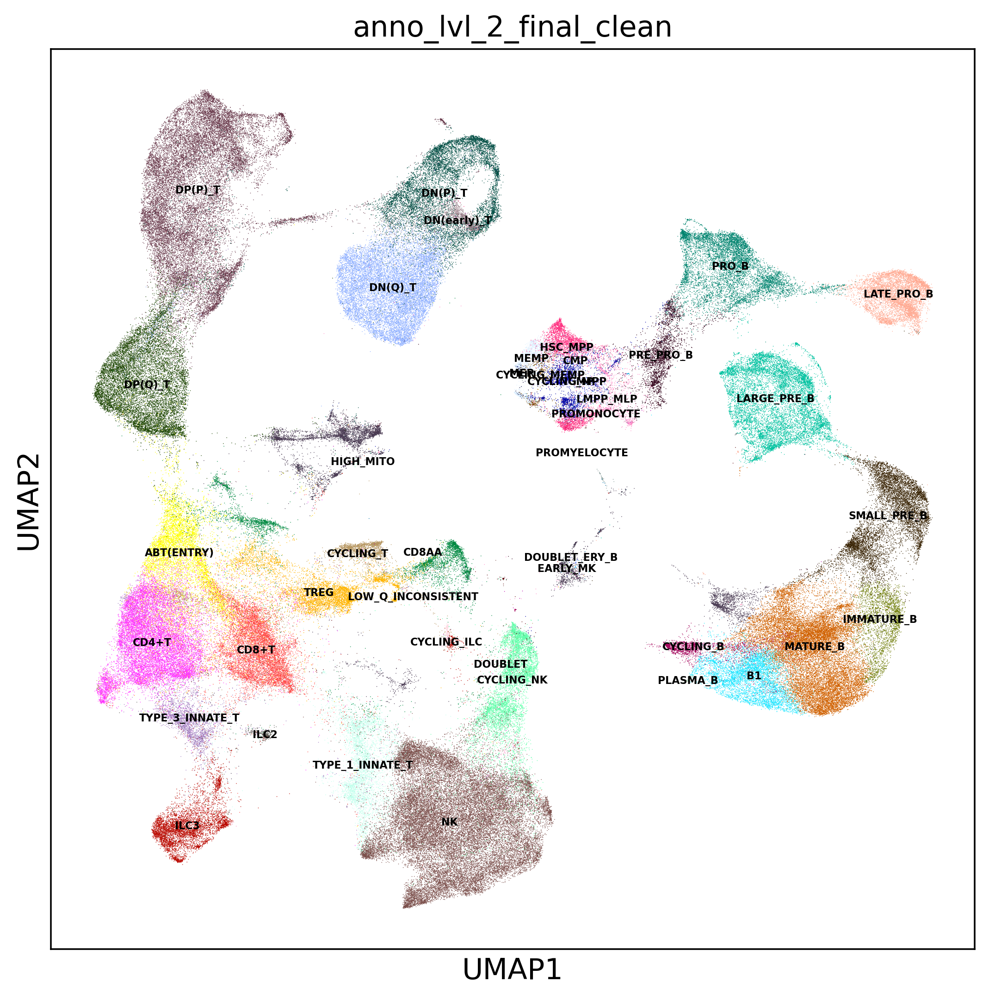

In [8]:
plt.rcParams["figure.figsize"] = [8,8]
sc.pl.umap(adata,color=['anno_lvl_2_final_clean'],legend_loc='on data',legend_fontsize=5)

# Overall UMAP

In [8]:
# load similarity score from adult immune merge
# merged = sc.read('/nfs/team205/ed6/data/Fetal_immune/panimmune_LYMPHOID_query.mapped2LYMPHOID.withReference.h5ad')
# adata.obs['mnn_sim_ratio'] = lookup([barcode +'-reference' for barcode in adata.obs_names], merged.obs, -1, 'mnn_sim_ratio')

Only considering the two last: ['.withReference', '.h5ad'].
Only considering the two last: ['.withReference', '.h5ad'].


In [10]:
B = adata[adata.obs['anno_lvl_2_final_clean'].isin(['IMMATURE_B','MATURE_B','CYCLING_B','B1','PLASMA_B'])]

In [11]:
B.obs['anno_lvl_2_final_clean'] = B.obs['anno_lvl_2_final_clean'].cat.reorder_categories(['IMMATURE_B','MATURE_B','B1',  'PLASMA_B','CYCLING_B'])

Trying to set attribute `.obs` of view, copying.


In [12]:
a = B.obsm['X_umap'][:,0] > 9
b = B.obsm['X_umap'][:,1] < 3
selectlist = [a and b for a,b in zip(a,b)]
B_plot = B[selectlist].copy()

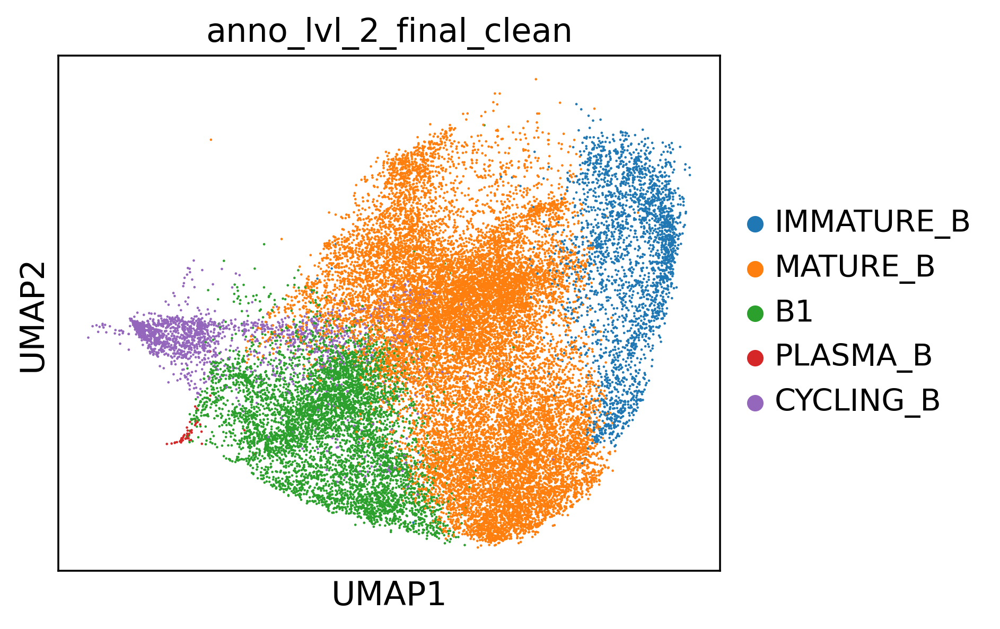

In [14]:
plt.rcParams["figure.figsize"] = [5,4]
sc.pl.umap(B_plot, color=['anno_lvl_2_final_clean'], save= 'Fig4_B1_matureBumap.pdf',palette = scjp.colors.vega_20_scanpy)

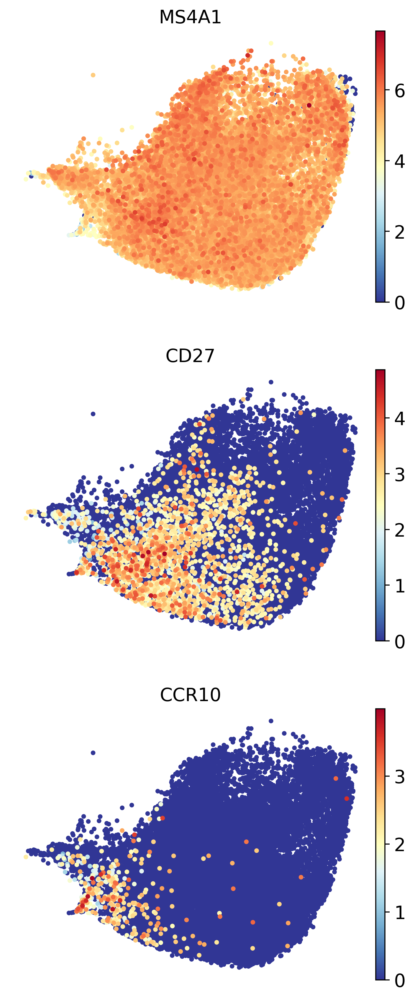

In [19]:
plt.rcParams["figure.figsize"] = [4.5,4]
genes = ['MS4A1','CD27','CCR10']
sc.pl.umap(B_plot,color=genes,legend_loc ='right margin',frameon=False,ncols=1,size=50,save='Fig4_B1_marker_genes.pdf')

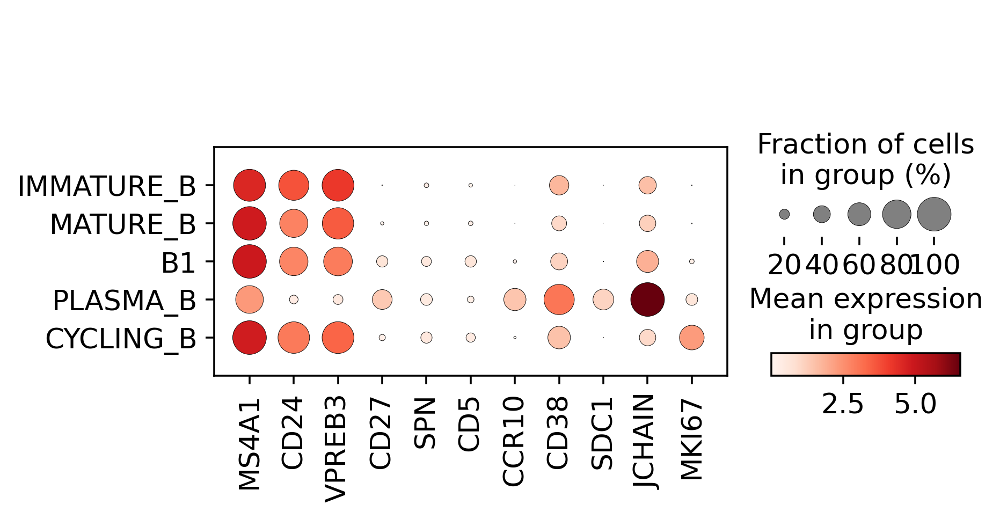

In [22]:
genes = ['MS4A1','CD24','VPREB3',
         'CD27','SPN','CD5','CCR10',
         'CD38','SDC1','JCHAIN','MKI67']
sc.pl.dotplot(B, var_names = genes, groupby='anno_lvl_2_final_clean')

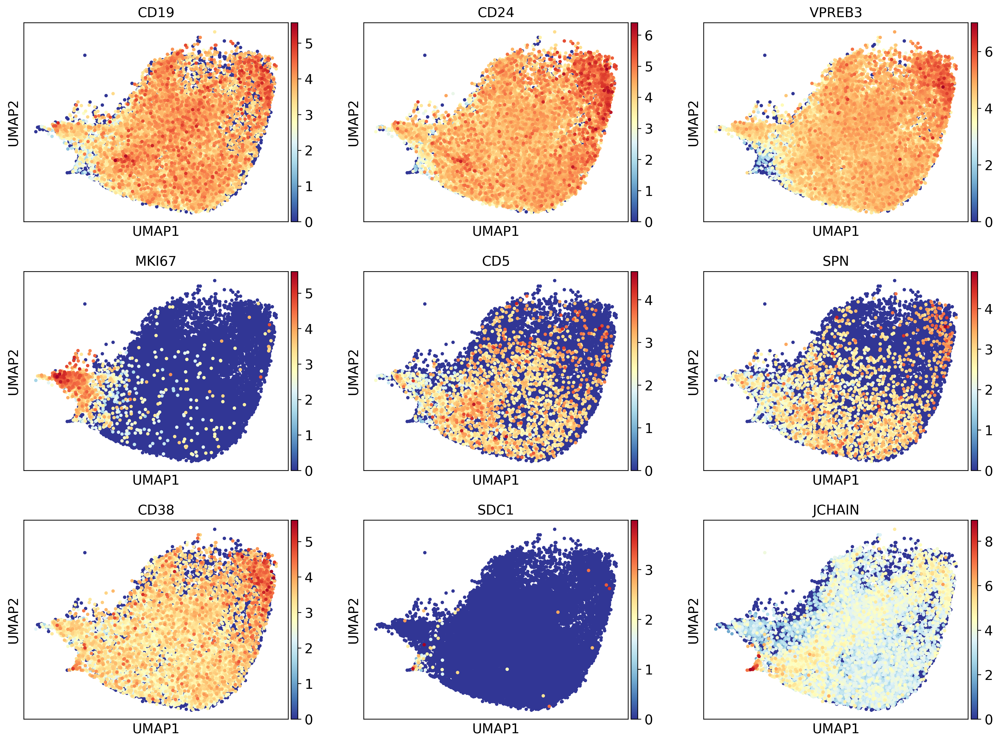

In [23]:
plt.rcParams["figure.figsize"] = [5,4]
genes = ['CD19','CD24','VPREB3','MKI67',
        'CD5','SPN',
         'CD38','SDC1','JCHAIN']
sc.pl.umap(B_plot,color=genes,legend_loc ='right margin',ncols=3,size=50,save='Fig4_all_other_marker_genes.pdf')

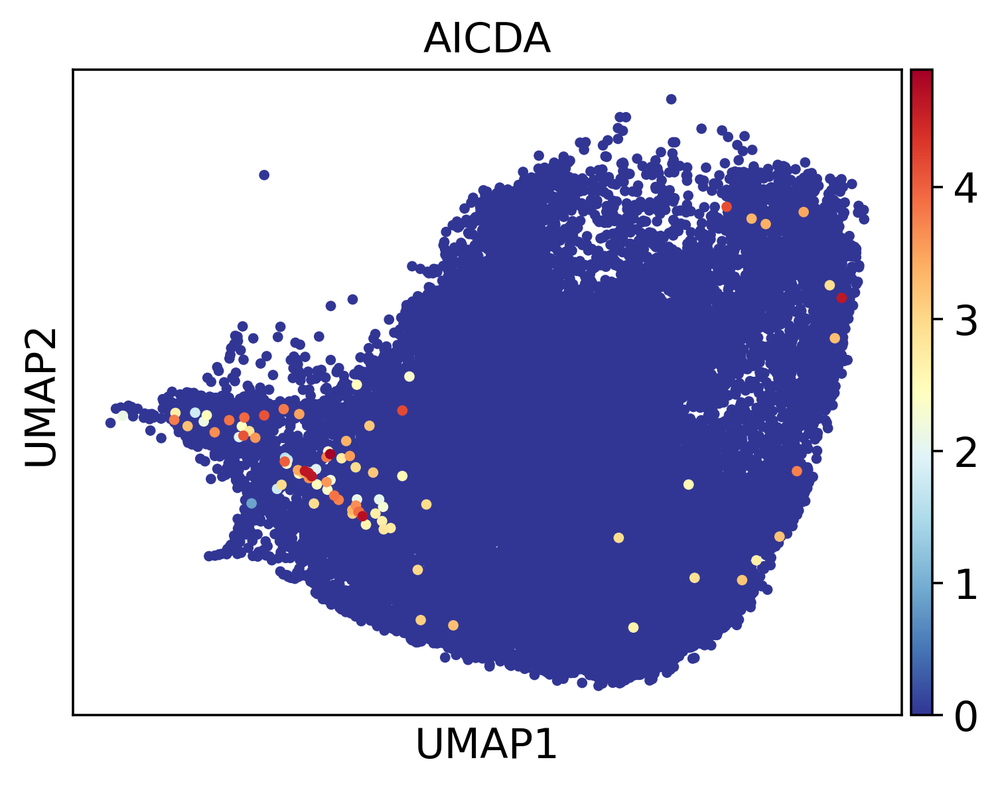

In [24]:
plt.rcParams["figure.figsize"] = [5.5,4]
sc.pl.umap(B_plot,color=['AICDA'],legend_loc ='right margin',
           legend_fontsize = 8,size=50,save='B_AICDA.pdf')

# Fraction of different mature B cells across organ/age

In [31]:
obs['donor_organ_sort']=np.char.array(obs['donor'],unicode=True)+'_'+np.char.array(obs['organ'],unicode=True)+'_'+np.char.array(obs['Sort_id'],unicode=True)

In [32]:
counter_tot = Counter(obs['donor_organ_sort'])

In [33]:
matureB = adata[adata.obs['anno_lvl_2_final_clean'].isin(['B1','CYCLING_B','MATURE_B','PLASMA_B'])]

In [34]:
adata_select = matureB[matureB.obs['Sort_id'].isin(['CD45N','CD45P','TOT'])]

In [35]:
adata_select.obs['donor_organ']=np.char.array(adata_select.obs['donor'],unicode=True)+'_'+np.char.array(adata_select.obs['organ'],unicode=True)
adata_select.obs['donor_organ_sort']=np.char.array(adata_select.obs['donor_organ'],unicode=True)+'_'+np.char.array(adata_select.obs['Sort_id'],unicode=True)
adata_select.obs['donor_organ']=adata_select.obs['donor_organ'].astype('category')
adata_select.obs['donor_organ_sort'] = adata_select.obs['donor_organ_sort'].astype('category')

Trying to set attribute `.obs` of view, copying.


In [36]:
sort_fraction = pd.read_csv('metadata/220621_FACs_gating_proportions_correct.csv')

In [37]:
adata_select.obs['sort_fraction'] = lookup(adata_select.obs['file'], sort_fraction, 'Sample.lanes','parent_Multiplier')

In [38]:
### group by donor_organ_sort

In [39]:
cc1 = pd.DataFrame(index =list(adata_select.obs['donor_organ_sort'].cat.categories), columns = list(adata_select.obs['anno_lvl_2_final_clean'].cat.categories)+['total'])

In [40]:
for donor_organ_sort in cc1.index:
    counter = Counter(adata_select[adata_select.obs['donor_organ_sort']==donor_organ_sort].obs['anno_lvl_2_final_clean'])
    cc1.loc[donor_organ_sort,'total']=counter_tot[donor_organ_sort]
    for cell in cc1.columns[:-1]:
        cc1.loc[donor_organ_sort,cell] = counter[cell]
    #cluster_counter.loc['B1%',sample]=counterB1[sample] / counterB[sample]
cc1 = cc1.astype('int64')

In [41]:
cc1['sort'] = [str(a).split('_')[-1] for a in cc1.index]
cc1['age'] = lookup(cc1.index, adata_select.obs, 'donor_organ_sort', 'age').astype('int64')
cc1['donor_organ'] = ['_'.join(str(a).split('_')[:-1]) for a in cc1.index]
cc1['sort_fraction'] = lookup(cc1.index, adata_select.obs, 'donor_organ_sort', 'sort_fraction')
cc1.loc[cc1['sort_fraction'].isna(), 'sort_fraction'] = 1
cc1['B1_weighted'] = cc1['B1'] * cc1['sort_fraction']
cc1['B2_weighted'] = cc1['MATURE_B'] * cc1['sort_fraction']

In [42]:
cc2 = cc1.groupby('donor_organ').agg('sum')
cc2['B1/B2 ratio'] = cc2['B1_weighted'] / cc2['B2_weighted']
cc2['age'] = lookup(cc2.index, adata_select.obs, 'donor_organ', 'age').astype('int64')
cc2['organ'] = [str(a).split('_')[1] for a in cc2.index]
cc2['B1B2'] = cc2['B1'] + cc2['MATURE_B']
bin_names = np.array(['7-9 pcw', '10-12 pcw', '13-15 pcw', '16-17 pcw']) # bin ages 
cc2['age_bin'] = bin_names[np.digitize(cc2['age'], [10, 13, 16])]
cc2['age_bin'] = cc2['age_bin'].astype('category').cat.reorder_categories(bin_names)
cc2['age_organ'] = cc2['age_bin'].astype('str') + '_' + cc2['organ'].astype('str')
cc2['weighted_raito'] = cc2['B1/B2 ratio'] * cc2['B1B2']
cc2 = cc2.loc[cc2['B1B2'] >=5, :]

In [43]:
tmp = cc2.groupby(['age_organ']).agg('sum')
cc3 = cc2.groupby(['age_organ']).first()
cc3['B1/B2 ratio'] = tmp['weighted_raito'] / tmp['B1B2']
cc3 = cc3.loc[:, ['B1/B2 ratio', 'B1B2', 'age_bin', 'age']]
cc3['organ'] = [str(a).split('_')[1] for a in cc3.index]
cc3['log ratio'] = np.log2(cc3['B1/B2 ratio'])
cc3['log count'] = np.log10(cc3['B1B2'])

In [44]:
cc3

,B1/B2 ratio,B1B2,age_bin,age,organ,log ratio,log count
age_organ,,,,,,,
10-12 pcw_BM,0.161290,36,10-12 pcw,12,BM,-2.632268,1.556303
10-12 pcw_KI,0.244817,6,10-12 pcw,12,KI,-2.030226,0.778151
10-12 pcw_LI,0.486715,32,10-12 pcw,11,LI,-1.038850,1.505150
10-12 pcw_SK,0.163986,122,10-12 pcw,12,SK,-2.608351,2.086360
10-12 pcw_SP,0.433621,107,10-12 pcw,11,SP,-1.205492,2.029384
10-12 pcw_TH,1.610500,6,10-12 pcw,11,TH,0.687509,0.778151
13-15 pcw_BM,0.162443,43,13-15 pcw,14,BM,-2.621995,1.633468
13-15 pcw_GU,0.271429,89,13-15 pcw,15,GU,-1.881356,1.949390
13-15 pcw_LI,0.389299,281,13-15 pcw,14,LI,-1.361050,2.448706


In [45]:
cc3['organ']=cc3['organ'].astype('category')
cc3['organ']=cc3['organ'].cat.set_categories(organ_order).cat.remove_unused_categories()
cc3['organ'] = cc3['organ'].cat.rename_categories(['Liver', 'Bone Marrow', 'Thymus', 'Spleen', 'Skin', 'Gut', 'Kidney'])
organ_color_map = dict(zip(organ_name_order, np.array(sb.color_palette('tab10'))[range(len(organ_order))]))

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


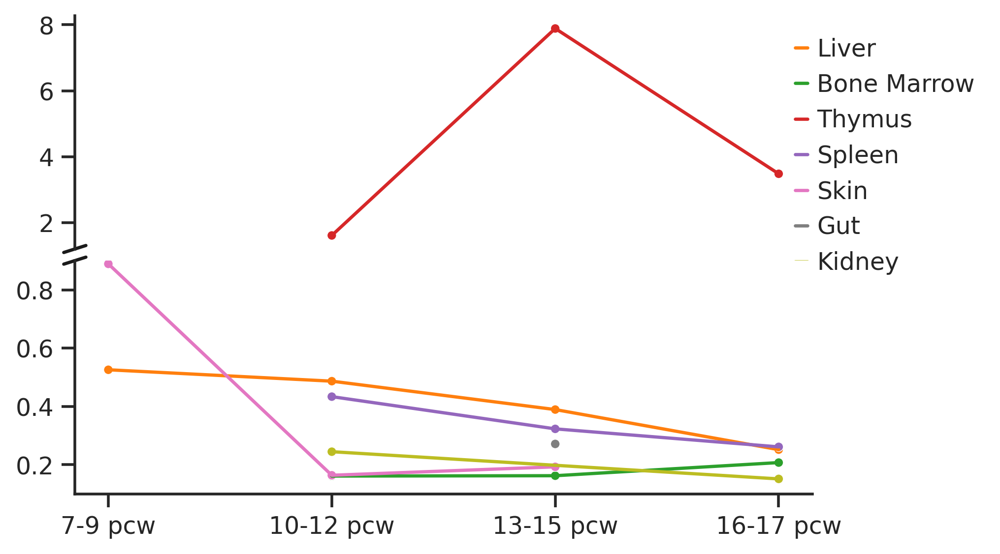

In [46]:
sb.set_theme(style='ticks')
f, (ax_top, ax_bottom) = plt.subplots(ncols=1, nrows=2, sharex=True, gridspec_kw={'hspace':0.05},figsize=(6,4))
g1 = sb.lineplot(data=cc3, x='age_bin', y='B1/B2 ratio', hue='organ',ax=ax_top,palette=organ_color_map)
s1 = sb.scatterplot(cc3.loc[:,'age_bin'], cc3.loc[:,'B1/B2 ratio'], hue=cc3.loc[:,'organ'],size=10,
                    ax=ax_top,palette=organ_color_map)
g2 = sb.lineplot(data=cc3, x='age_bin', y='B1/B2 ratio', hue='organ',ax=ax_bottom,palette=organ_color_map)
s2 = sb.scatterplot(cc3.loc[:,'age_bin'], cc3.loc[:,'B1/B2 ratio'], hue=cc3.loc[:,'organ'],size=10,
                    ax=ax_bottom,palette=organ_color_map)

ax_top.set_ylim(bottom=1.2)   # those limits are fake
ax_bottom.set_ylim(0.1,0.9)

sb.despine(ax=ax_bottom)
sb.despine(ax=ax_top, bottom=True)

ax = ax_top
d = .015  # how big to make the diagonal lines in axes coordinates
# arguments to pass to plot, just so we don't keep repeating them
kwargs = dict(transform=ax.transAxes, color='k', clip_on=False)
ax.plot((-d, +d), (-d, +d), **kwargs)        # top-left diagonal

ax2 = ax_bottom
kwargs.update(transform=ax2.transAxes)  # switch to the bottom axes
ax2.plot((-d, +d), (1 - d, 1 + d), **kwargs)  # bottom-left diagonal

#remove legend 
#ax_top.legend_.remove()
ax_bottom.legend_.remove()
ax_top.set_ylabel('')    
ax_top.set_xlabel('')
ax_bottom.set_ylabel('')    
ax_bottom.set_xlabel('')
ax_top.tick_params(bottom=False)
h,l = ax_top.get_legend_handles_labels()
l1 = ax_top.legend(h[:7], l[:7],loc='upper right',bbox_to_anchor=(1.25, 1),frameon=False)
plt.savefig(fig_path+'Fig4_B1_B2_ratio_across_age.pdf',bbox_inches='tight')

# Disentangle the identity of different B cell types in CYCLING_B fraction --> show fraction of cycling cells in B1 vs B2

### use celltypist (logistic regression) to predict which cycling_B cells are B1 vs B2

In [47]:
import celltypist
from celltypist import models

In [48]:
celltypist.__version__

'0.1.5'

In [49]:
# remove cycling genes 
cc_genes = [x.strip() for x in open('/home/jovyan/gene_list/cc_genes.txt')]

In [50]:
B_nocc = B[:,~(B.var_names.isin(cc_genes))].copy()
B_nocc.raw = B_nocc.copy()

In [51]:
adata_new=B_nocc.copy()
#adata_new.var.index = adata_new.var['gene_names']
sc.pp.normalize_per_cell(adata_new,counts_per_cell_after=1e4,key_n_counts='total_counts')
sc.pp.log1p(adata_new)

In [52]:
adata_training = adata_new[~(adata_new.obs['anno_lvl_2_final_clean']=='CYCLING_B')].copy()
adata_test = adata_new[adata_new.obs['anno_lvl_2_final_clean']=='CYCLING_B'].copy()

In [59]:
model = celltypist.train(adata_training, 'anno_lvl_2_final_clean', check_expression = False, n_jobs = 10, feature_selection = True)

🍳 Preparing data before training
✂️ 10125 non-expressed genes are filtered out
⚖️ Scaling input data
🏋️ Training data using logistic regression
🔎 Selecting features
🧬 1562 features are selected
🏋️ Starting the second round of training
🏋️ Training data using logistic regression
✅ Model training done!


In [60]:
model.write('panfetal_B_celltypist.pkl')

In [53]:
predictions = celltypist.annotate(adata_test, model = 'panfetal_B_celltypist.pkl', majority_voting = False)

🔬 Input data has 1909 cells and 32995 genes
🔗 Matching reference genes in the model
🧬 1562 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!


In [54]:
adata_test = predictions.to_adata()

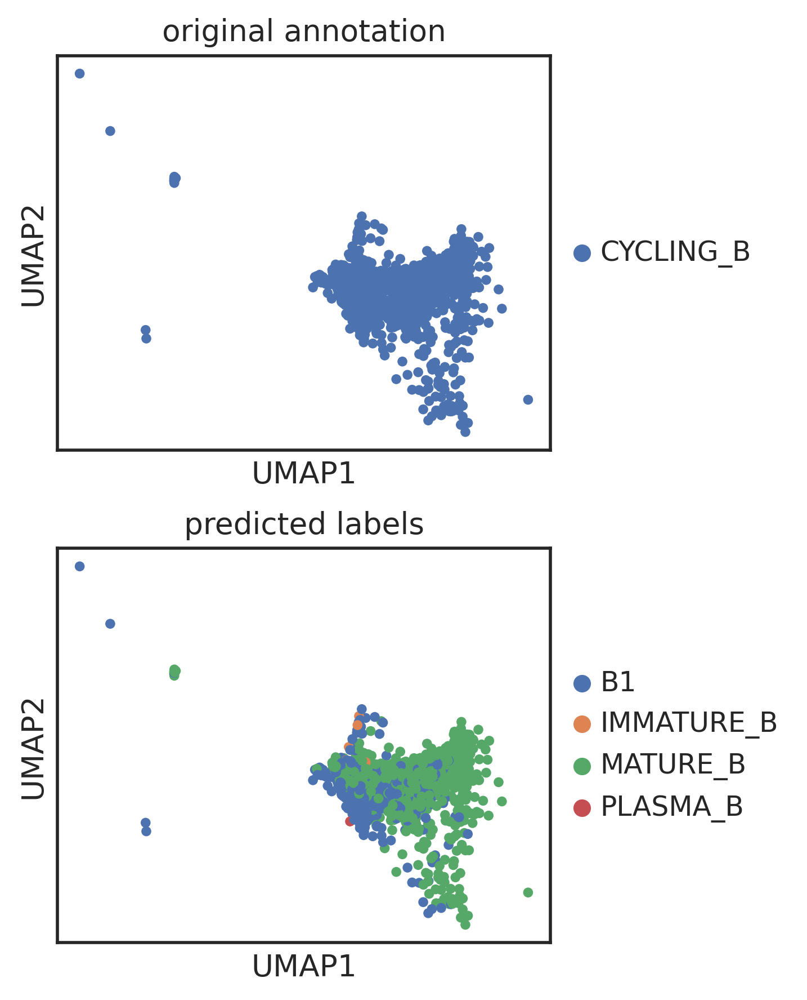

In [55]:
plt.rcParams["figure.figsize"] = [3,3]
sc.pl.umap(adata_test, color=['anno_lvl_2_final_clean','predicted_labels'], title=['original annotation','predicted labels'],ncols=1,save='cyclingb_lr.pdf')

In [56]:
B.obs['B_prediction'] = B.obs['anno_lvl_2_final_clean'].astype('str')
B.obs.loc[B.obs_names.isin(adata_test.obs_names),'B_prediction'] = lookup(B.obs_names[B.obs_names.isin(adata_test.obs_names)],
                                                                                         adata_test.obs,-1,'predicted_labels')
B.obs['B_prediction'] = B.obs['B_prediction'].astype('category')

In [57]:
B.obs['anno_lvl_2_final_clean'] = B.obs['anno_lvl_2_final_clean'].cat.reorder_categories(['IMMATURE_B','MATURE_B','B1',  'PLASMA_B','CYCLING_B'])
B.obs['B_prediction'] = B.obs['B_prediction'].cat.reorder_categories(['IMMATURE_B','MATURE_B', 'B1', 'PLASMA_B'])

In [37]:
B.write_h5ad('write/B_lr.h5ad')

In [58]:
B=sc.read('write/B_lr.h5ad')

In [59]:
B_plot.obs['B_prediction']=lookup(B_plot.obs_names, B.obs, -1,'B_prediction')
B_plot.obs['B_prediction'] =B_plot.obs['B_prediction'].astype('category')
B_plot.obs['B_prediction'] = B_plot.obs['B_prediction'].cat.reorder_categories(['IMMATURE_B','MATURE_B', 'B1', 'PLASMA_B'])

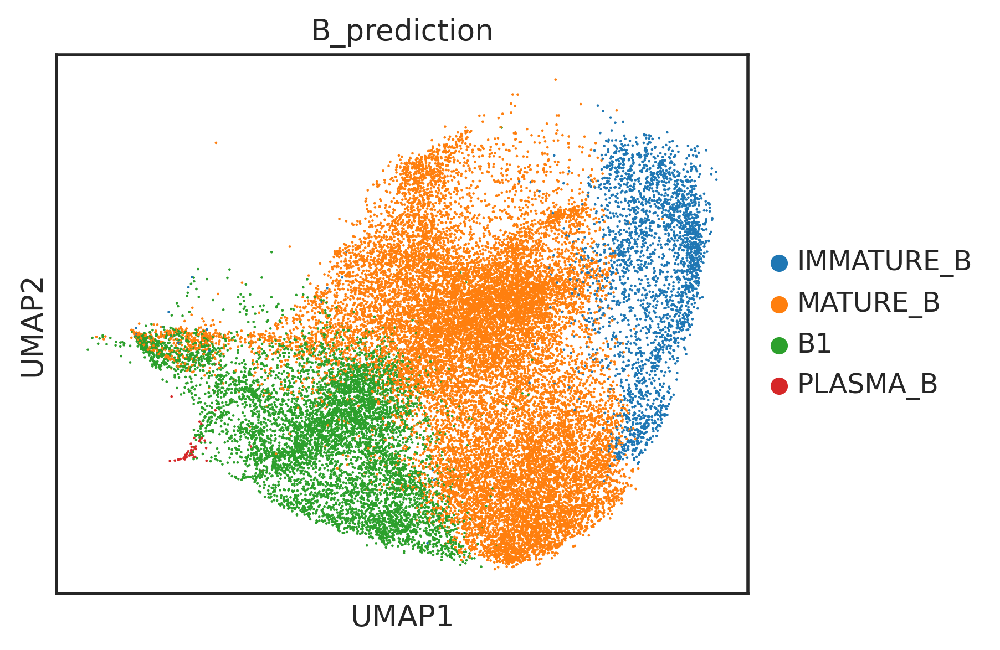

In [60]:
plt.rcParams["figure.figsize"] = [5,4]
sc.pl.umap(B_plot,color=['B_prediction'],ncols=1,palette = scjp.colors.vega_20_scanpy)

### build table of number of cycling cells within each B cell subtype

In [61]:
# MKI67 expression > 0 are counted as cycling cells
exp = np.array(B[:,'MKI67'].X.todense()).flatten()
exp_new = exp[exp>0] 

(array([ 50., 147., 232., 291., 327., 325., 270., 146.,  33.,   6.]),
 array([1.3617051, 1.7865849, 2.2114646, 2.6363444, 3.0612242, 3.486104 ,
        3.910984 , 4.3358636, 4.7607436, 5.185623 , 5.610503 ],
       dtype=float32),
 <BarContainer object of 10 artists>)

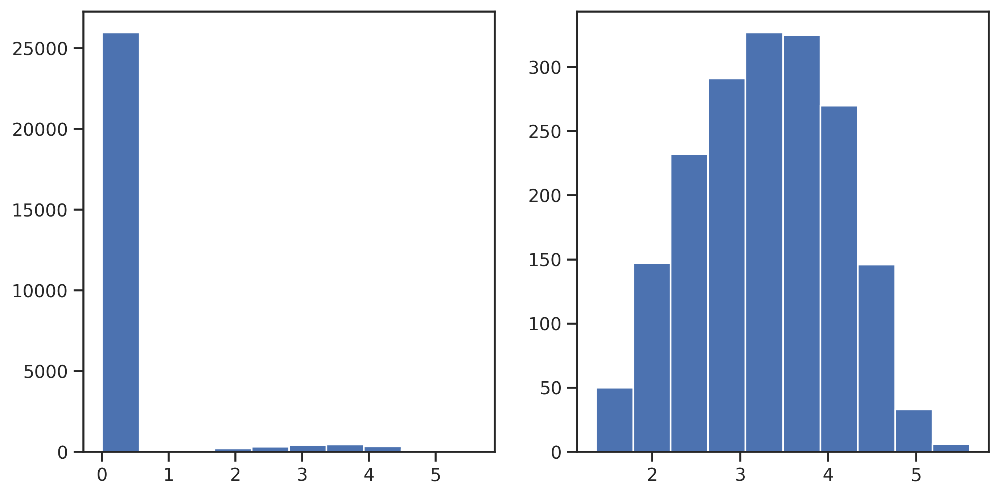

In [62]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(10,5))
ax1.hist(exp)
ax2.hist(exp_new)
# 0 is a good cutoff

In [63]:
df= pd.DataFrame(index=['IMMATURE_B','MATURE_B','B1','PLASMA_B'], columns = ['cycling','noncycling','total'])

In [64]:
proliferating = list(exp>0) # MKI67 log expression more than 0
for cell in df.index:
    celllist = list(B.obs['B_prediction']==cell)
    df.loc[cell,'cycling'] = sum(a and b for a, b in zip(proliferating, celllist))
    
    df.loc[cell,'total'] = sum(celllist)
    
    df.loc[cell,'noncycling'] = df.loc[cell,'total'] - df.loc[cell,'cycling']

In [65]:
df

,cycling,noncycling,total
IMMATURE_B,30,2676,2706
MATURE_B,649,17885,18534
B1,1132,5366,6498
PLASMA_B,16,46,62


In [66]:
df_perc= pd.DataFrame({'% cycling cells': df['cycling'] / df['total'] * 100,
                       'cell type':df.index})

In [67]:
df_perc

,% cycling cells,cell type
IMMATURE_B,1.10865,IMMATURE_B
MATURE_B,3.50167,MATURE_B
B1,17.4207,B1
PLASMA_B,25.8065,PLASMA_B


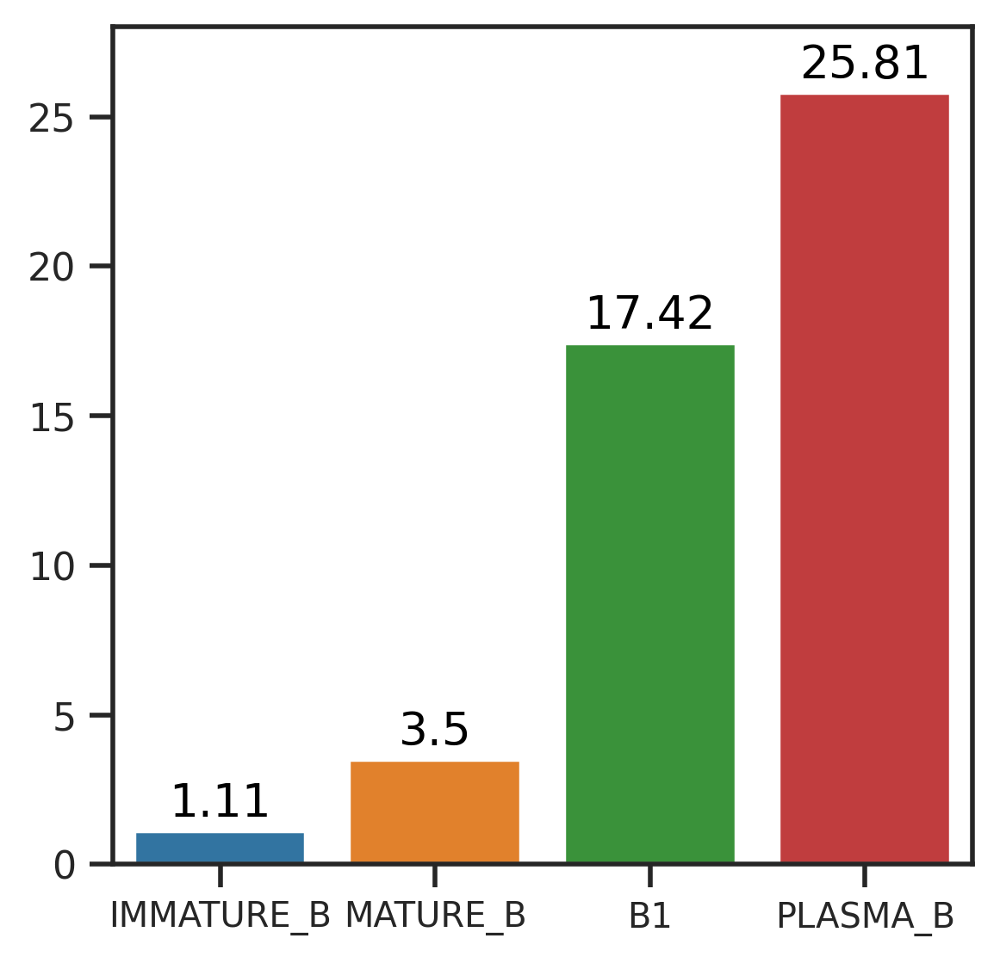

In [68]:
sb.set_theme(style="ticks")
fig, ax = plt.subplots(figsize=(4,4))

ax = sb.barplot(x="cell type", y="% cycling cells", data=df_perc,palette='tab10')
ax.set_ylim(0,28)
ax.set(xlabel=None,ylabel=None)
for i in range(df_perc.shape[0]):
    ax.text(i,df_perc['% cycling cells'][i]+0.5, round(df_perc['% cycling cells'][i],2), color='black', ha="center",fontsize=12)

plt.xticks(fontsize=9)
plt.yticks(fontsize=10)
plt.savefig(fig_path+'cycling_b_perc.pdf')

### chi-square significance test

In [69]:
sig = pd.DataFrame(columns=['OR','pval','adj_pval'],index = ['B1-MATURE_B','B1-PLASMA_B','MATURE_B-PLASMA_B',
                                                             'B1-IMMATURE_B','PLASMA_B-IMMATURE_B','MATURE_B-IMMATURE_B'])

In [70]:
for ct in sig.index:
    ct_select = [ct.split('-')[0]] +[ct.split('-')[1]]
    observed = df.loc[ct_select,['cycling','noncycling']]
    
    sig.loc[ct,'OR'] = (observed.iloc[0,0] / observed.iloc[1,0]) / (observed.iloc[0,1] / observed.iloc[1,1])
    _, sig.loc[ct,'pval'], _, _ = sp.stats.chi2_contingency(observed=observed)

In [71]:
# for adjusted pval calculation
from rpy2.robjects.packages import importr
from rpy2.robjects.vectors import FloatVector
stats = importr('stats') 

In [72]:
sig.loc[:,'adj_pval']=stats.p_adjust(FloatVector(sig.loc[:,'pval']), method = 'BH')

In [73]:
sig

,OR,pval,adj_pval
B1-MATURE_B,5.81353,3.22035e-308,1.932208e-307
B1-PLASMA_B,0.606504,0.118379,1.183794e-01
MATURE_B-PLASMA_B,0.104326,9.0578e-20,1.358670e-19
B1-IMMATURE_B,18.8174,6.67541e-102,2.002624e-101
PLASMA_B-IMMATURE_B,31.0261,6.89236e-48,1.378472e-47
MATURE_B-IMMATURE_B,3.23684,5.68746e-11,6.824953e-11


### group by organ

In [74]:
proliferating = list(np.array(B[:,'MKI67'].X.todense()).flatten()>0)
B.obs['cycling']=0
B.obs.loc[proliferating, 'cycling']='cycling'
df_total = B.obs
df_total.to_csv('csv/B1_cycling_lr.csv')

In [75]:
df = pd.DataFrame(columns = ['ct','organ','cycling%','total'],index = range(36))

In [76]:
ctl = list(set(B.obs['B_prediction']))
organl = list(set(B.obs['organ']))
df.loc[:,['ct','organ']] = np.array([(x, y) for x in ctl for y in organl])

In [77]:
for i in df.index: 
    ct = df['ct'][i]
    organ = df['organ'][i]
    a = np.array(B.obs['B_prediction']==ct)
    b = np.array(B.obs['organ']==organ)
    c = np.array(B.obs['cycling']=='cycling')
    
    df['total'][i] = sum(a&b)
    df['cycling%'][i] = sum(a&b&c)/sum(a&b) *100

In [78]:
df1 = df.loc[df['total']>=10,:]

In [79]:
df1['ct'] = df1['ct'].astype('category')
df1['ct'] = df1['ct'].cat.reorder_categories(['IMMATURE_B','MATURE_B','B1','PLASMA_B'])
ct_num = dict({'IMMATURE_B':0,'MATURE_B':1,'B1':2,'PLASMA_B':3})
df1['ct_num'] = [ct_num[a] for a in df1['ct']]
random.seed(1712)
df1['ct_num'] = df1['ct_num'].astype('float') + np.random.uniform(low=-0.1,high=0.1,size=df1.shape[0])*1.5 #change ct to float with gitter
df1['log10(cell count)']=np.log10(df1['total'].astype('float'))

<ipython-input-79-208b76586873>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['ct'] = df1['ct'].astype('category')
<ipython-input-79-208b76586873>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['ct'] = df1['ct'].cat.reorder_categories(['IMMATURE_B','MATURE_B','B1','PLASMA_B'])
<ipython-input-79-208b76586873>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation:

In [80]:
organ_color_map = dict(zip(organ_order, np.array(sb.color_palette('tab10'))[range(len(organ_order))]))

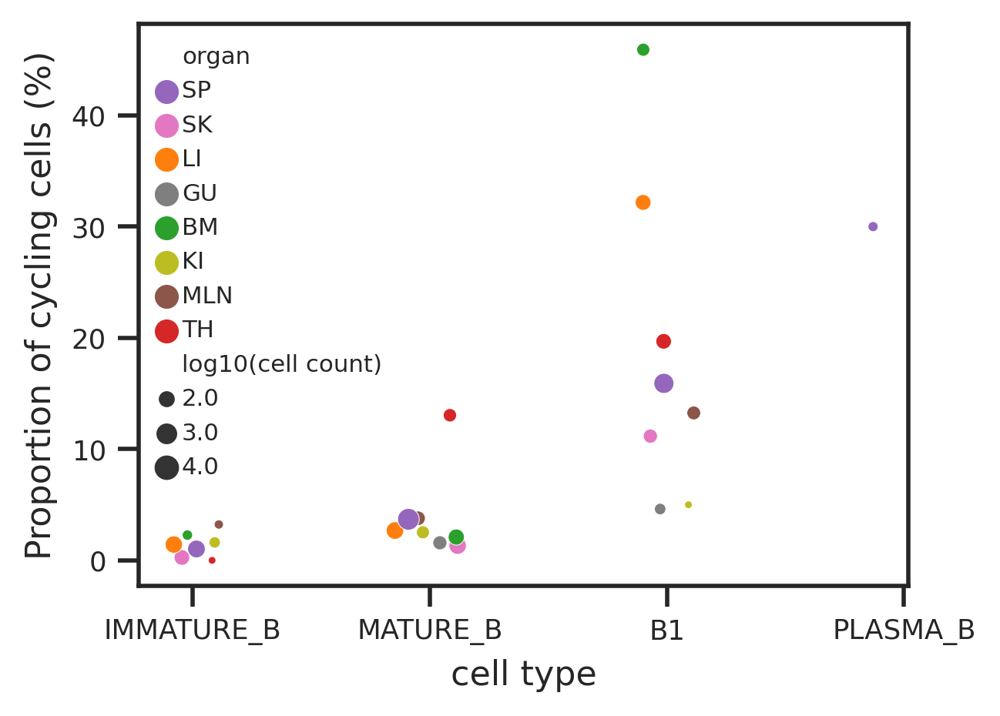

In [81]:
sb.set_theme(style='ticks')
fig, ax = plt.subplots(figsize=(4,3))
s = sb.scatterplot(x = 'ct_num', y ='cycling%', data=df1, hue='organ',size='log10(cell count)',sizes = (5,40),palette=organ_color_map)
s.set_ylabel('Proportion of cycling cells (%)', fontsize=10)
s.set_xlabel('cell type', fontsize=10)
ax.set_xticklabels([0,'IMMATURE_B','MATURE_B','B1','PLASMA_B'])
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
ax.xaxis.grid(False)
h,l = ax.get_legend_handles_labels()
l1 = ax.legend(h[:10]+[h[-5]]+[h[-3]]+[h[-1]],l[:10]+[l[-5]]+[l[-3]]+[l[-1]], loc='upper left',frameon=False, fontsize='xx-small')
plt.savefig(fig_path+'B1_cycling.pdf',bbox_inches='tight')

In [82]:
%load_ext rpy2.ipython

In [83]:
%%R
### use LR to compare the cycling %
df = read.csv('csv/B1_cycling_lr.csv')
df = df[,c('age','organ','donor','cycling','B_prediction')]
df$cycling <- df$cycling == 'cycling'
summary(glm(cycling ~ age+organ+B_prediction, data=df))


Call:
glm(formula = cycling ~ age + organ + B_prediction, data = df)

Deviance Residuals: 
     Min        1Q    Median        3Q       Max  
-0.29659  -0.05279  -0.03704  -0.02487   1.01314  

Coefficients:
                        Estimate Std. Error t value Pr(>|t|)    
(Intercept)             0.274851   0.015807  17.388  < 2e-16 ***
age                    -0.004058   0.000821  -4.943 7.74e-07 ***
organGU                -0.087406   0.017367  -5.033 4.86e-07 ***
organKI                -0.056099   0.019247  -2.915 0.003563 ** 
organLI                -0.020533   0.010467  -1.962 0.049815 *  
organMLN               -0.048989   0.014689  -3.335 0.000854 ***
organSK                -0.071402   0.011111  -6.426 1.33e-10 ***
organSP                -0.045341   0.009283  -4.884 1.04e-06 ***
organTH                -0.001700   0.013803  -0.123 0.901977    
organYS                -0.110789   0.120394  -0.920 0.357466    
B_predictionIMMATURE_B -0.165005   0.005817 -28.368  < 2e-16 ***
B_predictio

# DGEs in B1 vs B2

In [193]:
b1b2 = adata[adata.obs['anno_lvl_2_final_clean'].isin(['B1','MATURE_B'])]

In [194]:
sc.tl.rank_genes_groups(b1b2, 'anno_lvl_2_final_clean', method = 'wilcoxon', use_raw = True)
result = b1b2.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_clusters = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})
wilcox_clusters.head(10)

# potentially specific markers: ERICH3, CLEC4C, ADTRP

Trying to set attribute `.uns` of view, copying.


,B1_n,B1_l,B1_p,MATURE_B_n,MATURE_B_l,MATURE_B_p
0,S100A4,2.707838,0.0,HLA-DPB1,1.365999,0.000000e+00
1,CLECL1,3.379001,0.0,RPL18A,0.319466,0.000000e+00
2,ARHGAP24,2.448439,0.0,HLA-DRA,0.842158,0.000000e+00
3,CCDC50,1.815329,0.0,RPS12,0.319301,0.000000e+00
4,RGS10,2.259784,0.0,RPL13,0.229239,0.000000e+00
5,CD44,1.882257,0.0,RPS3A,0.239052,0.000000e+00
6,GAPDH,0.800185,0.0,TSPAN13,1.912071,3.233939e-307
7,RAC2,0.834533,0.0,RPL32,0.230951,2.059242e-302
8,S100A10,3.237761,0.0,RPL9,0.307716,1.183188e-300
9,ARPC1B,1.415486,0.0,RPS13,0.269367,4.643767e-279


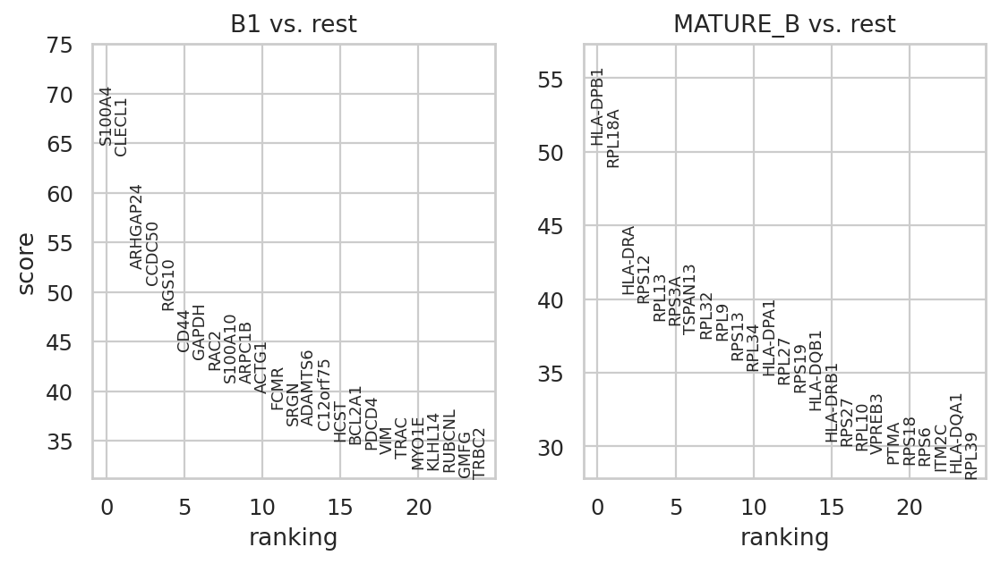

In [195]:
sc.pl.rank_genes_groups(b1b2, n_genes=25, sharey=False, save='b1b2_wilcox.pdf')
wilcox_clusters.to_csv('csv/b1b2_wilcox.csv', index = False, sep = ',')
# CCR10 found here CCR10	4.6335583 (B1_l)	1.61E-06 (B1_p)

In [196]:
m = scjp.markers.marker(b1b2,'anno_lvl_2_final_clean')

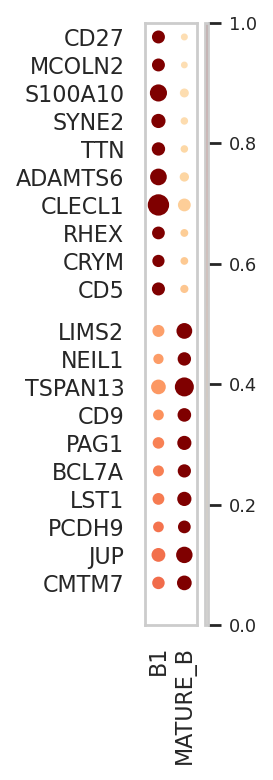

{'B1': ['CD27',
  'MCOLN2',
  'S100A10',
  'SYNE2',
  'TTN',
  'ADAMTS6',
  'CLECL1',
  'RHEX',
  'CRYM',
  'CD5'],
 'MATURE_B': ['LIMS2',
  'NEIL1',
  'TSPAN13',
  'CD9',
  'PAG1',
  'BCL7A',
  'LST1',
  'PCDH9',
  'JUP',
  'CMTM7']}

In [197]:
m.plot_marker()

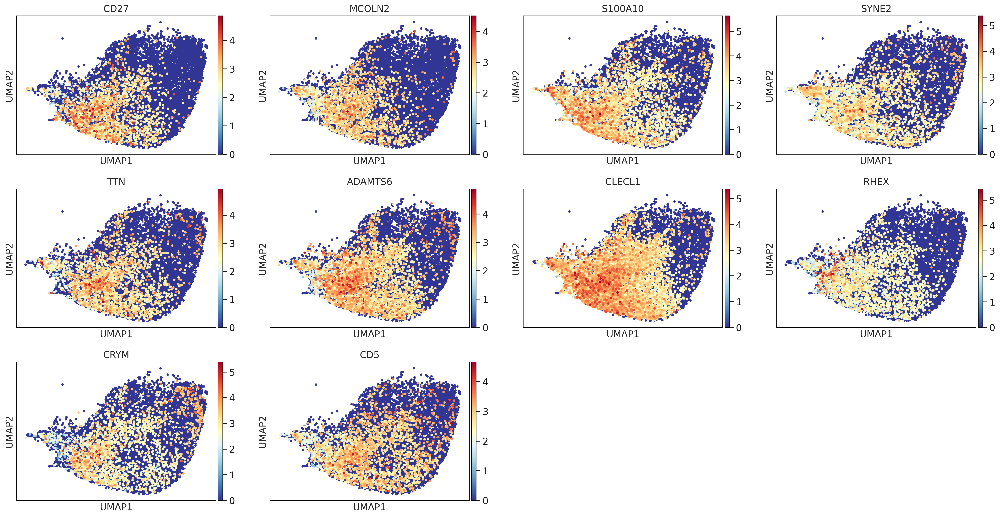

In [117]:
genes = ['CD27',
  'MCOLN2',
  'S100A10',
  'SYNE2',
  'TTN',
  'ADAMTS6',
  'CLECL1', #This protein may act as a T-cell costimulatory molecule that enhances interleukin-4 production
  'RHEX',
  'CRYM',
  'CD5']
sc.pl.umap(B_plot, color=genes,color_map = 'RdYlBu_r',size=50)

### expression of CCR10 ligand

In [84]:
stroma = sc.read('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.STROMA.embedding.h5ad')

Only considering the two last: ['.embedding', '.h5ad'].
Only considering the two last: ['.embedding', '.h5ad'].


In [89]:
stroma = stroma[~stroma.obs_names.isin(maternal_barcodes['barcodes'])]

In [90]:
for col in obs:
    stroma.obs[col] = obs[col] # use anno_lvl_2_final_clean

Trying to set attribute `.obs` of view, copying.


In [92]:
df = pd.DataFrame(index = set(stroma.obs['anno_lvl_2_final_clean']), columns = ['CCL27','CCL28'])
for gene in df.columns:
    data_sl = stroma[:,gene].X.todense()
    anno = stroma.obs['anno_lvl_2_final_clean']
    for ct in df.index:
        df.loc[ct, gene]=np.mean(data_sl[anno==ct,])
df = df.fillna(0)    

In [93]:
df1 = df.loc[np.array(df['CCL27']> 0.05) |  np.array(df['CCL28']> 0.05)]

In [94]:
stroma_select = stroma[stroma.obs['anno_lvl_2_final_clean'].isin(df1.index)]

Trying to set attribute `.obs` of view, copying.
... storing 'file' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'predicted_doublets' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'uniform_label' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'uniform_label_expanded_merged' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'uniform_label_lvl0' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'organ' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'Sample.lanes' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'Sort_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'method' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'donor' as categorical
Trying to 

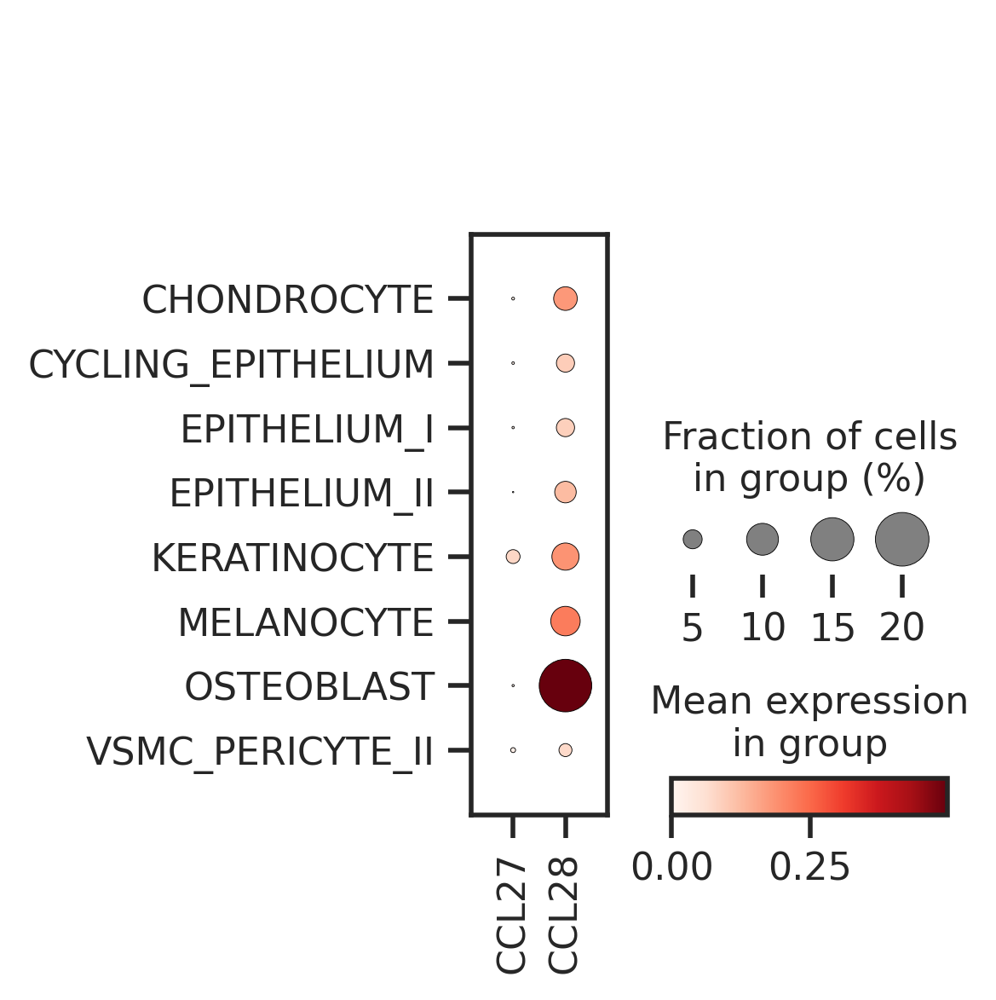

In [95]:
sc.pl.dotplot(stroma_select, var_names = ['CCL27','CCL28'],groupby='anno_lvl_2_final_clean',save='Fig4_B1_CCR10_ligand.pdf')

# BCR comparison for B1 vs mature B

In [96]:
# load productive BCR
BCR = pd.read_csv('/lustre/scratch117/cellgen/team297/kt16/panfetal/PAN.A01.v01.entire_data_normalised_log.20210429.LYMPHOID.embedding_dandelion_productive.csv',
                 index_col=0)
BCR = BCR.loc[:,BCR.columns[26:]]

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (6,25,35,66) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [97]:
for col in BCR:
    adata.obs[col]=BCR[col]

Trying to set attribute `.obs` of view, copying.


In [98]:
# load metadata
meta = pd.read_csv('metadata/BCR_metadata_updated_20052021.csv')

In [99]:
adata_bcr = adata[adata.obs['file'].isin(meta['GEX file'])].copy()

### Plot expression pattern of Heavy and Light chains

In [100]:
adata_bcr.obs['anno_lvl_2_final_clean'] = adata_bcr.obs['anno_lvl_2_final_clean'].astype('category')
adata_bcr.obs['anno_lvl_2_final_clean'] = adata_bcr.obs['anno_lvl_2_final_clean'].cat.reorder_categories(['DN(early)_T','DN(P)_T','DN(Q)_T','DP(P)_T','DP(Q)_T','ABT(ENTRY)','CD8+T',
                                                                                                          'CD4+T','TREG','CYCLING_T','CD8AA','TYPE_3_INNATE_T','ILC3','ILC2','CYCLING_ILC',
                                                                                                          'TYPE_1_INNATE_T','NK','CYCLING_NK','HSC_MPP', 'CYCLING_MPP', 'LMPP_MLP',
                                                                                                          'MEMP','CYCLING_MEMP', 'MEP', 'EARLY_MK', 'CMP', 'GMP', 
                                                                                                          'PROMONOCYTE', 'PROMYELOCYTE','PRE_PRO_B','PRO_B','LATE_PRO_B',
                                                                                                          'LARGE_PRE_B','SMALL_PRE_B','IMMATURE_B','MATURE_B','CYCLING_B','B1','PLASMA_B',
                                                                                                          'LOW_Q_INCONSISTENT','DOUBLET', 'DOUBLET_ERY_B','HIGH_MITO'])

In [101]:
adata_bcr.obs['status_summary'] = adata_bcr.obs['status_summary'].astype('category')
adata_bcr.obs['status_summary'] = adata_bcr.obs['status_summary'].cat.reorder_categories(['IGH + IGK', 'IGH + IGL', 'IGH_only', 'No_contig'])

In [102]:
df = pd.DataFrame(index = adata_bcr.obs['anno_lvl_2_final_clean'].cat.categories, columns=adata_bcr.obs['status_summary'].cat.categories)
for ct in df.index:
    ct_filter = adata_bcr.obs['anno_lvl_2_final_clean']==ct
    counter = Counter(adata_bcr.obs.loc[ct_filter,'status_summary'])
    for status in df.columns:
        df.loc[ct,status] = counter[status]

In [103]:
df = df.loc[np.sum(df,axis=1)>=10,:]
df1 = df / np.array(np.sum(df,axis=1)).reshape(df.shape[0],1) * 100
df1['celltype']=df1.index

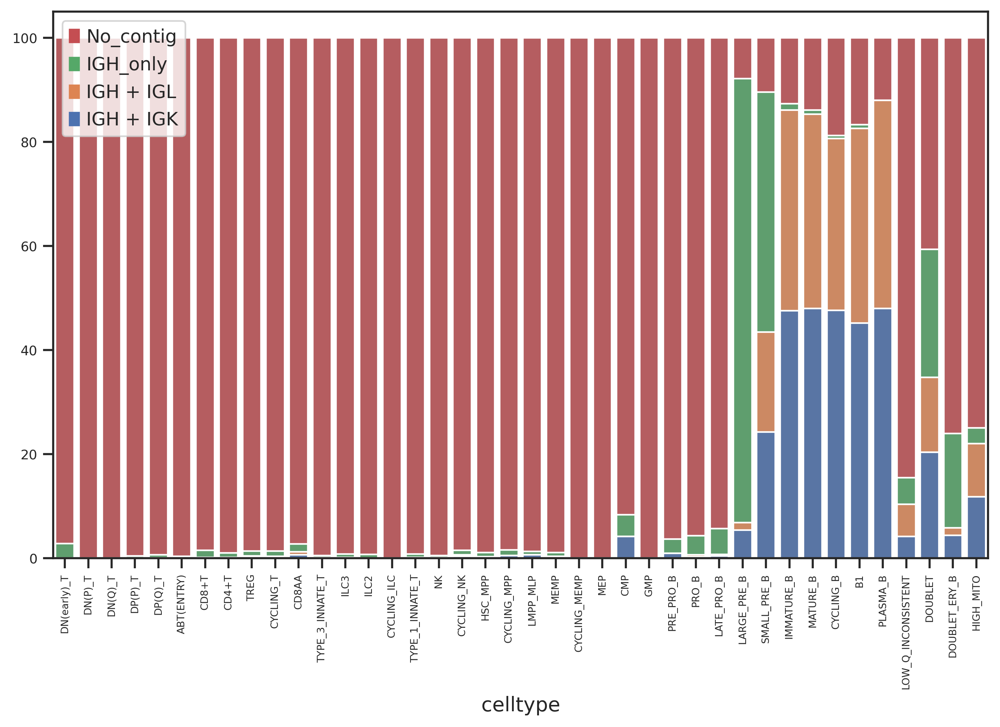

In [104]:
import matplotlib.patches as mpatches
plt.figure(figsize=(10, 6))

legend = []

for i in range(4)[::-1]:
    bar = sb.barplot(x='celltype',  y=np.sum(df1.iloc[:,0:i+1],axis=1), data=df1, color=sb.color_palette()[i])
    legend = legend+[mpatches.Patch(color=sb.color_palette()[i], label=df1.columns[i])]
plt.xticks(fontsize=6,rotation=90)
plt.yticks(fontsize=8)

# add legend
plt.legend(handles=legend)

In [105]:
B_all = adata_bcr[adata_bcr.obs['anno_lvl_2_final_clean'].isin(['PRE_PRO_B','PRO_B','LATE_PRO_B','LARGE_PRE_B','SMALL_PRE_B','IMMATURE_B',
                                            'MATURE_B','CYCLING_B','B1','PLASMA_B'])].copy()
B_all_plot = B_all[B_all.obsm['X_umap'][:,0]>7]

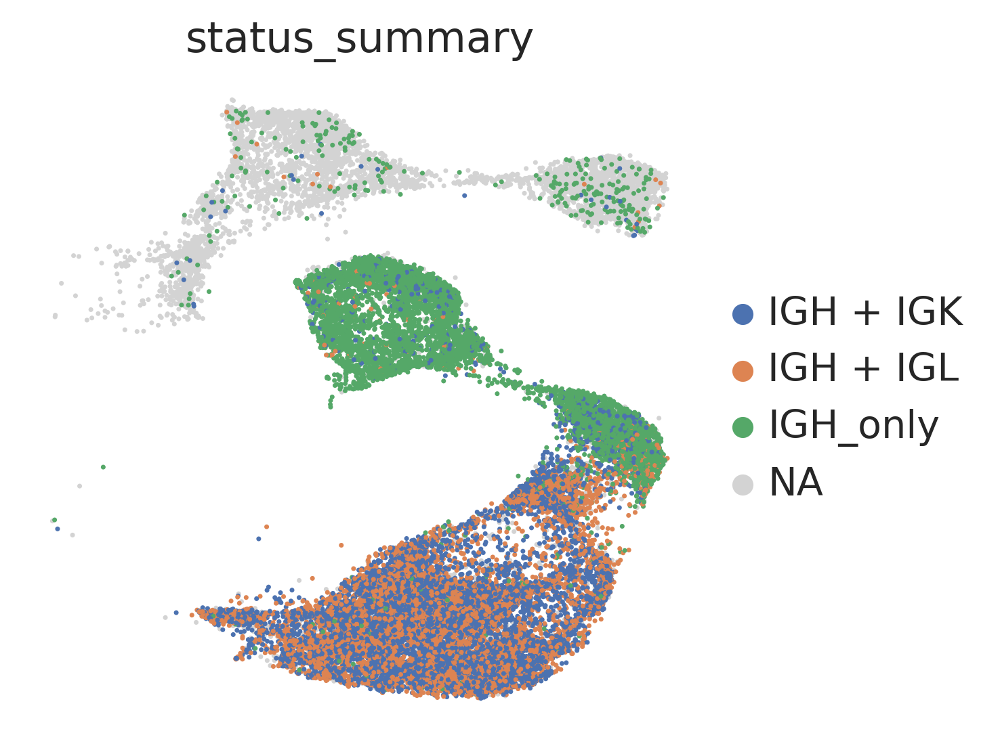

In [111]:
plt.rcParams["figure.figsize"] = [4,4]
sc.pl.umap(B_all_plot,color=['status_summary'],groups=['IGH + IGK', 'IGH + IGL', 'IGH_only'],frameon=False,size=10,save='Heavy_light_chain.pdf')

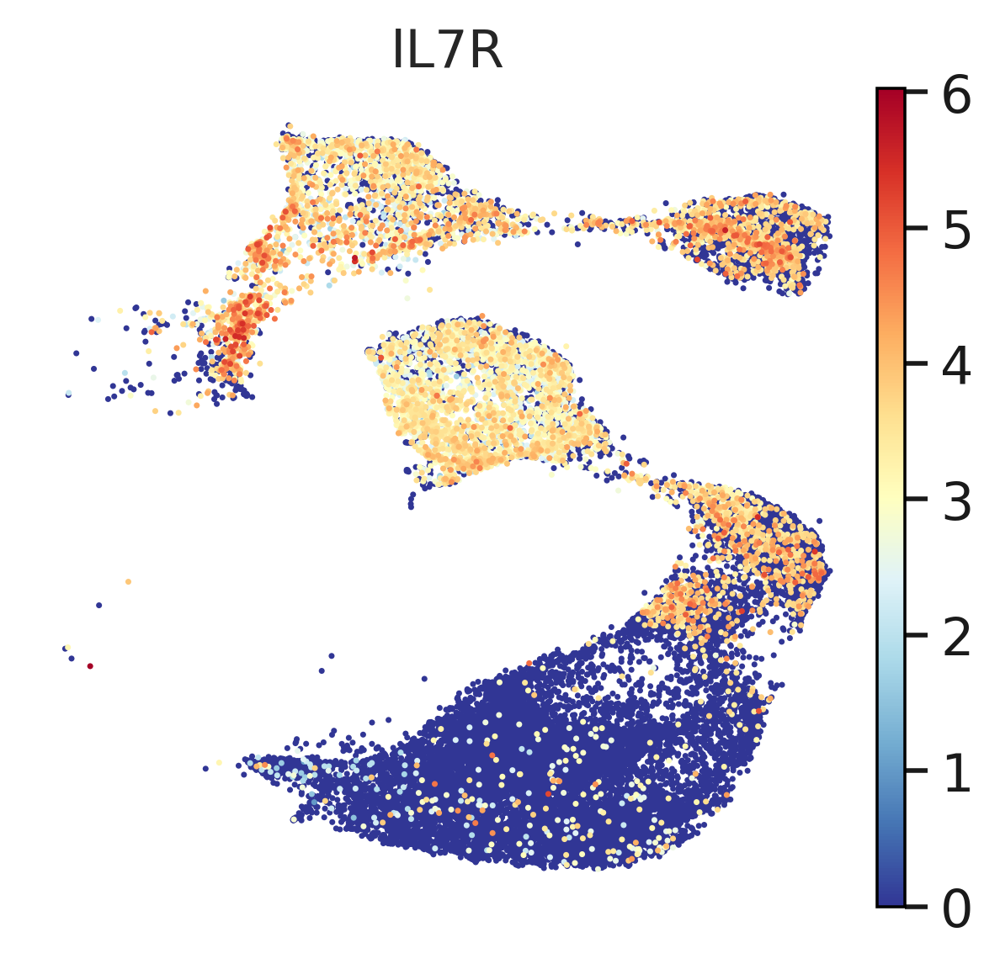

In [112]:
plt.rcParams["figure.figsize"] = [4.4,4]
sc.pl.umap(B_all_plot,color=['IL7R'],frameon=False,size=10,save='IL7R.pdf')

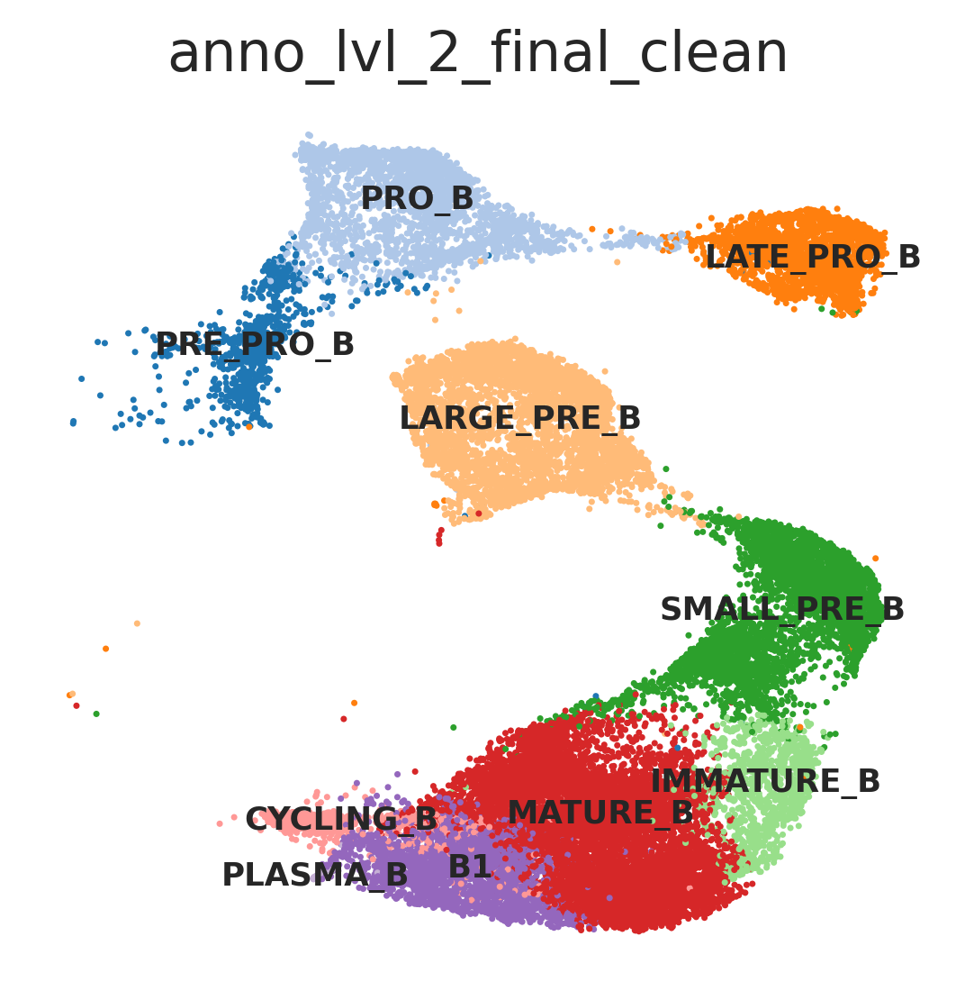

In [113]:
plt.rcParams["figure.figsize"] = [4,4]
sc.pl.umap(B_all_plot,color=['anno_lvl_2_final_clean'],frameon=False,legend_loc='on data',legend_fontsize=8,size=10,palette=sc.pl.palettes.vega_20,save='lymphoid_anno.pdf')

### further filtering adata_bcr and write the data

In [114]:
adata_bcr = adata_bcr[adata_bcr.obs['contig_QC_pass'] == 'True']

In [115]:
adata_bcr.write_h5ad('write/lymphoid_bcr_combine_productive.h5ad')

Trying to set attribute `.obs` of view, copying.
... storing 'has_contig' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'contig_QC_pass' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'clone_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'clone_id_by_size' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sample_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'locus_VDJ' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'locus_VJ' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'productive_VDJ' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'productive_VJ' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'v_call_genotyped_VDJ' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'v_call_genotyped_VJ' as cat

In [116]:
adata_bcr = sc.read('write/lymphoid_bcr_combine_productive.h5ad')

adata_bcr is the lymphoid with productive bcr, filtered by contig QC

# IGD/IGM clonotype choice in mature B cells

B_bcr is the mature B cells with productive bcr, filtered by contig QC

In [117]:
B_bcr = adata_bcr[adata_bcr.obs['anno_lvl_2_final_clean'].isin(['IMMATURE_B','MATURE_B','CYCLING_B','B1','PLASMA_B'])].copy()

In [118]:
B_bcr.obs['isotype_updated_IgD']=B_bcr.obs['isotype_updated_IgM']=B_bcr.obs['isotype_summary'].astype('str')
for cell in B_bcr.obs_names:
    if B_bcr.obs.loc[cell,'isotype_summary'] in ['IgD','IgD|IgM']:
        B_bcr.obs.loc[cell,'isotype_updated_IgD']= 'IgD'
    else: 
        B_bcr.obs.loc[cell,'isotype_updated_IgD']= 'no IgD'

for cell in B_bcr.obs_names:
    if B_bcr.obs.loc[cell,'isotype_summary'] in ['IgM','IgD|IgM']:
        B_bcr.obs.loc[cell,'isotype_updated_IgM']= 'IgM'
    else: 
        B_bcr.obs.loc[cell,'isotype_updated_IgM']= 'no IgM'

In [119]:
a = B_bcr.obsm['X_umap'][:,0] > 9
b = B_bcr.obsm['X_umap'][:,1] < 3
selectlist = [a and b for a,b in zip(a,b)]
B_bcr_plot = B_bcr[selectlist].copy()

In [120]:
B_bcr_plot.obs['isotype_updated_IgD']=B_bcr_plot.obs['isotype_updated_IgD'].astype('category')
sc.tl.embedding_density(B_bcr_plot, basis='umap', groupby='isotype_updated_IgD')

... storing 'isotype_updated_IgM' as categorical


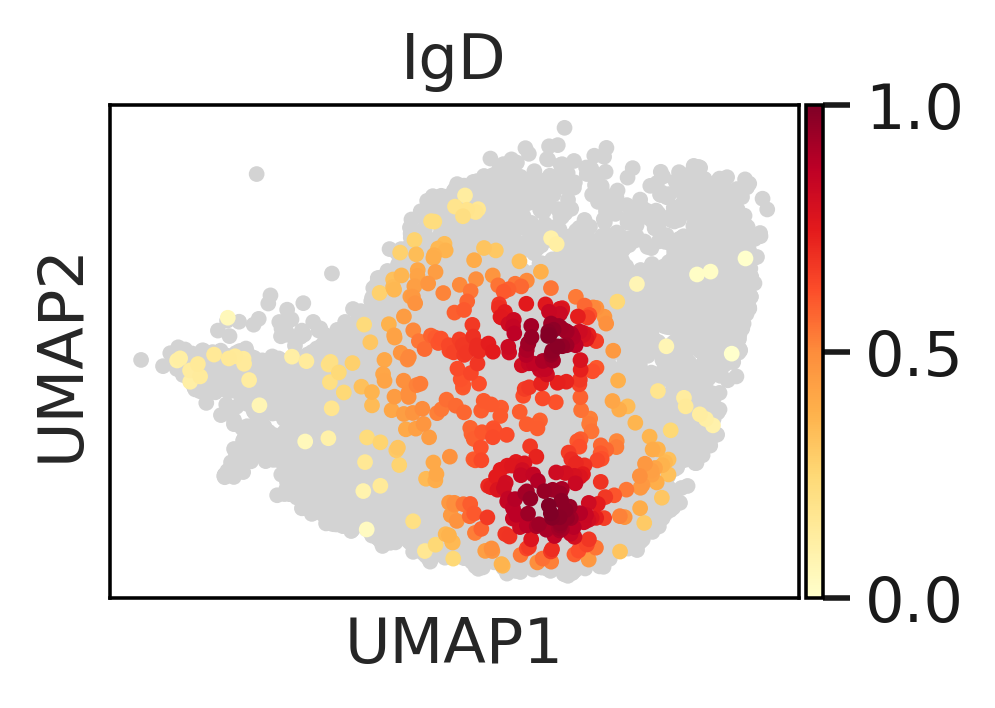

In [121]:
plt.rcParams["figure.figsize"] = [2.2,2]
sc.pl.embedding_density(B_bcr_plot,basis='umap', ncols=3,key='umap_density_isotype_updated_IgD',group=['IgD'],fg_dotsize =50,bg_dotsize=50)

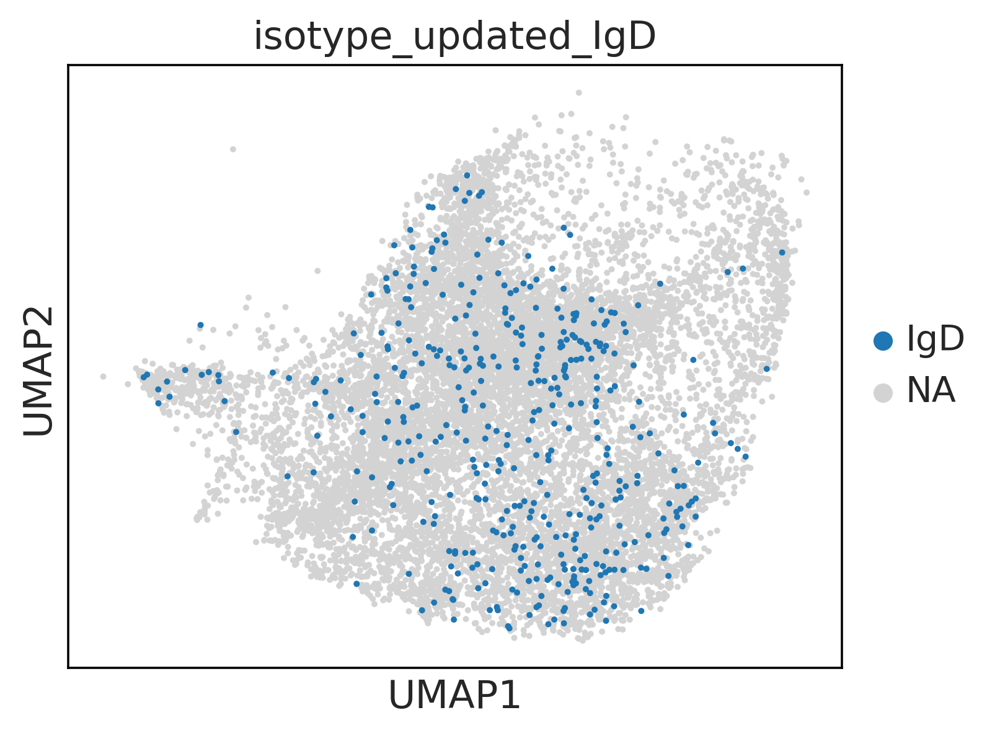

In [122]:
plt.rcParams["figure.figsize"] = [5,4]

sc.pl.umap(B_bcr_plot,color=['isotype_updated_IgD'],groups=['IgD'],size=20) 
### error may be caused by sb.set_theme(), solution - use upgraded scanpy or rerun without seaborn 

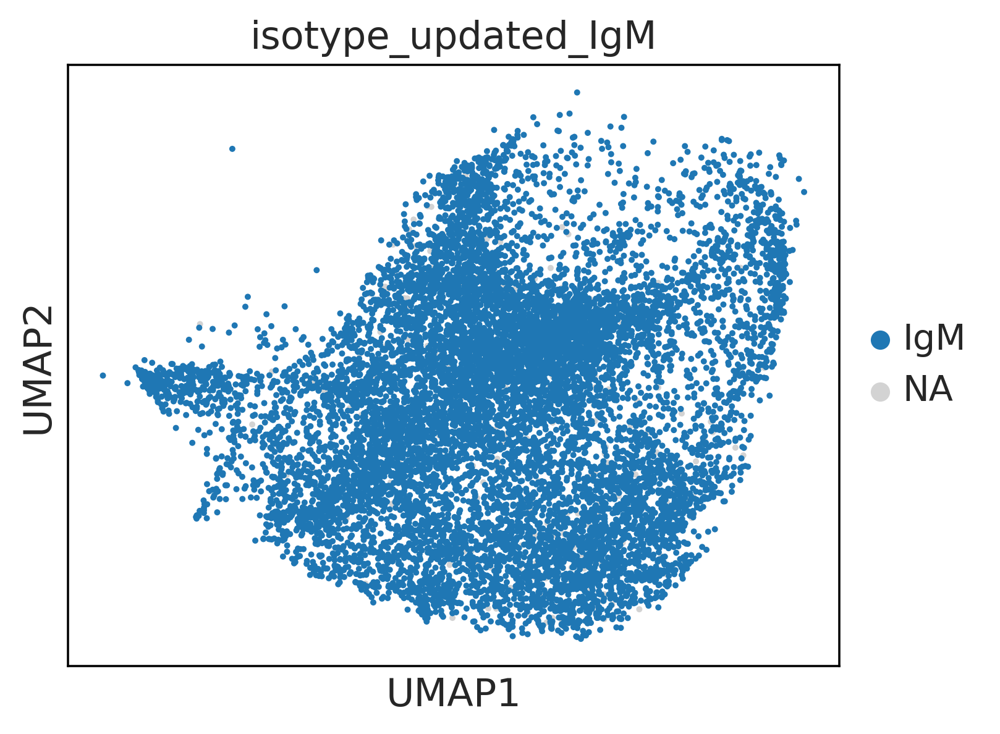

In [123]:
plt.rcParams["figure.figsize"] = [5,4]

sc.pl.umap(B_bcr_plot,color=['isotype_updated_IgM'],groups=['IgM'],size=20) 

... storing 'has_contig' as categorical
... storing 'contig_QC_pass' as categorical
... storing 'clone_id' as categorical
... storing 'clone_id_by_size' as categorical
... storing 'sample_id' as categorical
... storing 'locus_VDJ' as categorical
... storing 'locus_VJ' as categorical
... storing 'productive_VDJ' as categorical
... storing 'productive_VJ' as categorical
... storing 'v_call_genotyped_VDJ' as categorical
... storing 'v_call_genotyped_VJ' as categorical
... storing 'd_call_VDJ' as categorical
... storing 'j_call_VDJ' as categorical
... storing 'j_call_VJ' as categorical
... storing 'c_call_VDJ' as categorical
... storing 'c_call_VJ' as categorical
... storing 'duplicate_count_VDJ' as categorical
... storing 'duplicate_count_VJ' as categorical
... storing 'junction_aa_VDJ' as categorical
... storing 'junction_aa_VJ' as categorical
... storing 'status' as categorical
... storing 'status_summary' as categorical
... storing 'productive' as categorical
... storing 'productive_su

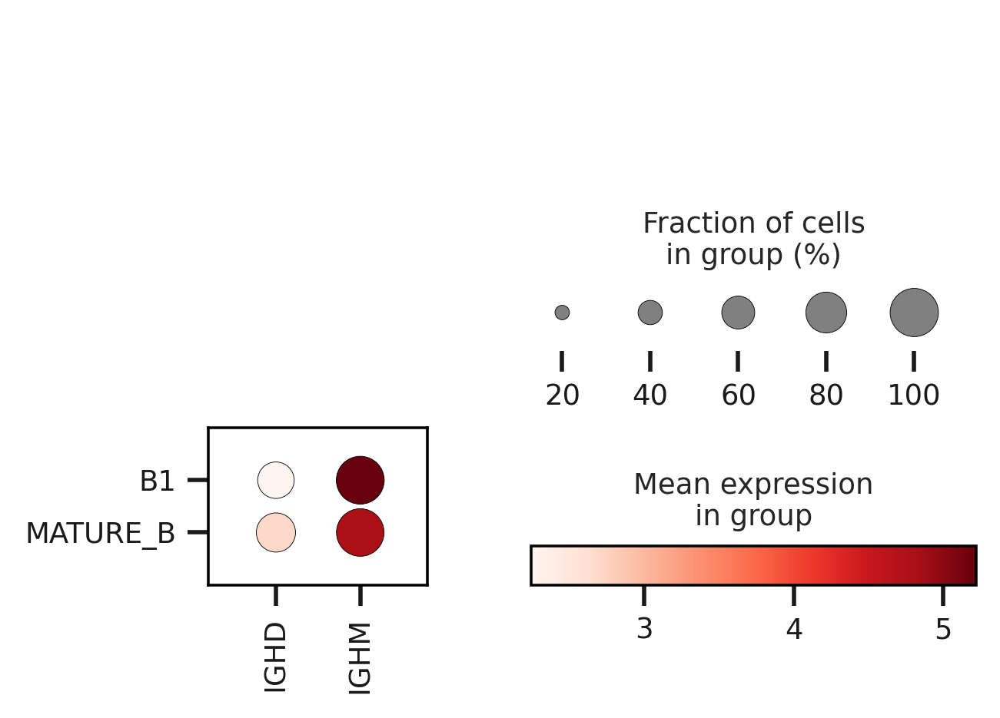

In [125]:
tmp = adata[adata.obs['anno_lvl_2_final_clean'].isin(['MATURE_B','B1'])].copy()
tmp.obs['anno_lvl_2_final_clean'] = tmp.obs['anno_lvl_2_final_clean'].cat.reorder_categories(['B1','MATURE_B'])

fig, ax = plt.subplots(figsize=(4,3))
plt.rcParams.update({'font.size': 10})   
sc.pl.dotplot(tmp, var_names=['IGHD','IGHM'],swap_axes=False,groupby=['anno_lvl_2_final_clean'], ax=ax,save='IGHD_IGHM.pdf')

In [126]:
tmp.obs['IGHD expression']=tmp[:,'IGHD'].X.todense()
tmp.obs['IGHM expression']=tmp[:,'IGHM'].X.todense()

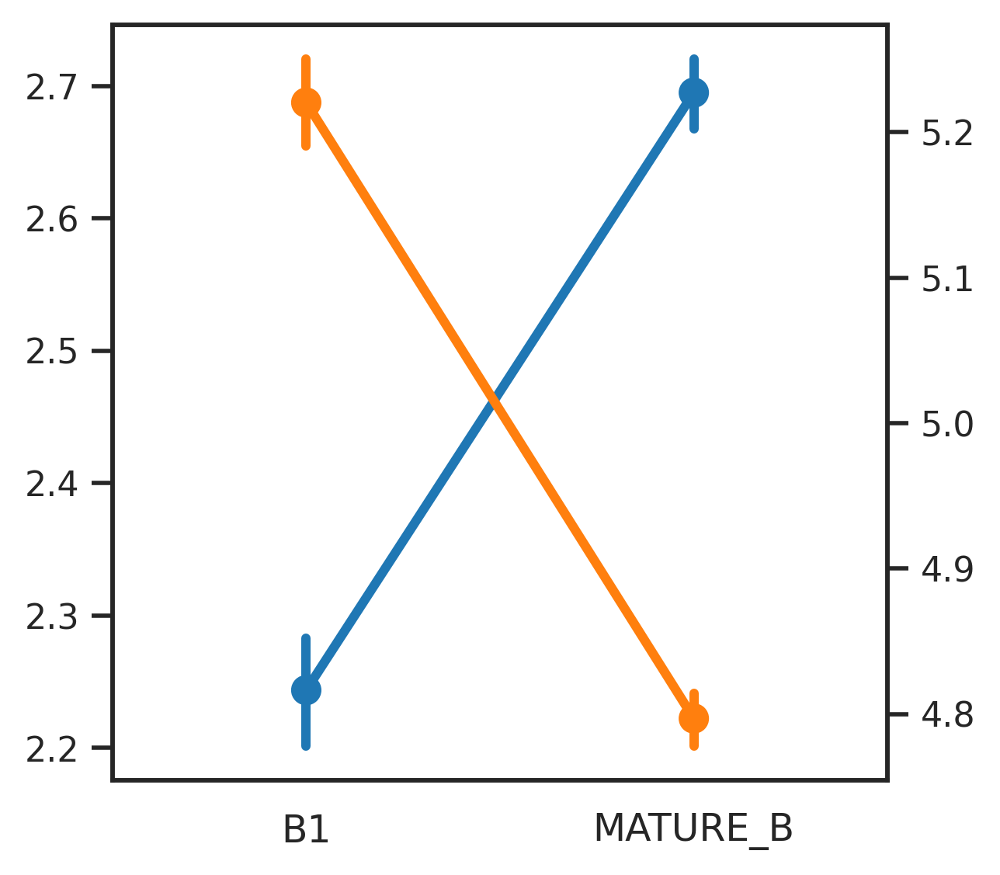

In [127]:
sb.set_theme(style="white")
fig, ax = plt.subplots(figsize=(4,4))
fig = sb.pointplot(data=tmp.obs, y='IGHD expression', x="anno_lvl_2_final_clean",color=sb.color_palette('tab10')[0])
ax2 = ax.twinx()
sb.pointplot(data=tmp.obs, y='IGHM expression', x="anno_lvl_2_final_clean",color=sb.color_palette('tab10')[1])
ax.set(xlabel=None,ylabel=None)
ax2.set(xlabel=None,ylabel=None)
ax.set_yticklabels(np.round(ax.get_yticks(),2), size = 10)
ax2.set_yticklabels(np.round(ax2.get_yticks(),2), size = 10)
plt.savefig(fig_path+'IgM_IgD.pdf',bbox_inches='tight')

# N-addition & mutation frequency B1 vs B2

In [218]:
bdata = B_bcr[B_bcr.obs['status'].isin(['IGH + IGK', 'IGH + IGL'])].copy() #choose cells that have both vdj and vj (11814 cells -> 11699 cells)

In [246]:
bdata.obs.loc[:,['mu_count','mu_count_VDJ','mu_count_VJ','mu_freq_VDJ','mu_freq_VJ', # mu_count = (mu_count_VDJ +mu_count_VJ)/2
                 'np1_length_VDJ','np2_length_VDJ','np1_length_VJ','junction_length_VDJ','junction_length_VJ']]

,mu_count,mu_count_VDJ,mu_count_VJ,mu_freq_VDJ,mu_freq_VJ,np1_length_VDJ,np2_length_VDJ,np1_length_VJ,junction_length_VDJ,junction_length_VJ
index,,,,,,,,,,
Human_colon_16S8159187-AGCTCTCAGTGTACTC,0.0,0.0,0.0,0.000000,0.0,7.0,2.0,0.0,45.0,33.0
Human_colon_16S8159187-TTAGGCATCAAGAAGT,0.0,0.0,0.0,0.000000,0.0,3.0,NaN,1.0,21.0,39.0
Human_colon_16S8159187-AGAATAGAGTGTGAAT,1.5,3.0,0.0,0.008596,0.0,6.0,8.0,0.0,51.0,36.0
Human_colon_16S8159187-TTCTACACATACAGCT,48.5,97.0,0.0,0.284457,0.0,2.0,0.0,0.0,54.0,36.0
Human_colon_16S8159187-CTGCTGTTCCACGTTC,0.0,0.0,0.0,0.000000,0.0,1.0,4.0,0.0,36.0,33.0
...,...,...,...,...,...,...,...,...,...,...
FCAImmP7803020-ACGATACCAAGCCGTC,0.0,0.0,0.0,0.000000,0.0,7.0,2.0,0.0,45.0,30.0
FCAImmP7803020-AGGGATGGTCGCGAAA,0.0,0.0,0.0,0.000000,0.0,1.0,1.0,0.0,24.0,39.0
FCAImmP7803020-GGATTACCAGATCCAT,0.0,0.0,0.0,0.000000,0.0,7.0,3.0,0.0,42.0,36.0


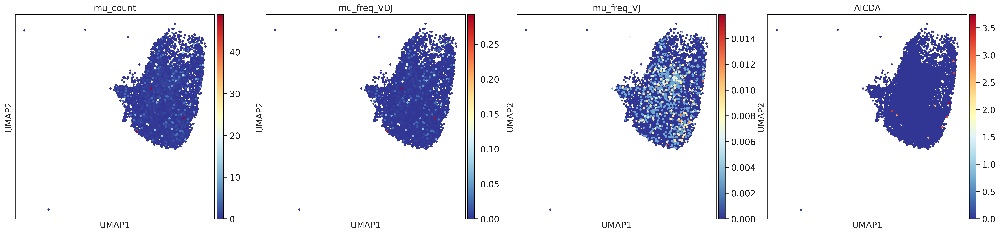

In [220]:
### look at where mutations are and AICDA expression
sc.pl.umap(bdata,color=['mu_count','mu_freq_VDJ','mu_freq_VJ','AICDA'],size=50)

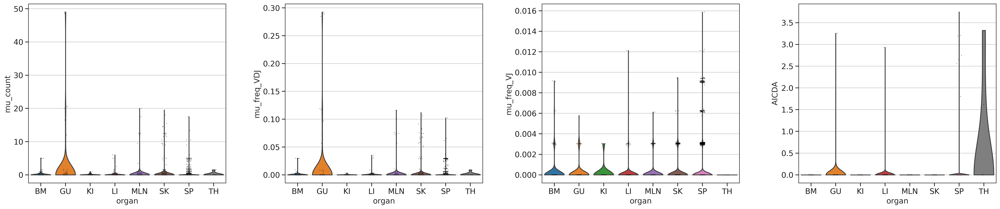

In [221]:
sc.pl.violin(bdata, keys=['mu_count','mu_freq_VDJ','mu_freq_VJ','AICDA'],groupby='organ')

## Compare N-addition length

In [182]:
## 776 cells don't have d gene called, so na for np2_length_vdj 
tb = bdata.obs.loc[bdata.obs['anno_lvl_2_final_clean'].isin(['B1','MATURE_B']), ['anno_lvl_2_final_clean','np1_length_VDJ','np2_length_VDJ','np1_length_VJ','junction_length_VDJ','junction_length_VJ','mu_freq_VDJ','mu_freq_VJ']]

In [183]:
tb["anno_lvl_2_final_clean"] = tb["anno_lvl_2_final_clean"].astype('str').astype('category')
tb["anno_lvl_2_final_clean"].cat.categories = ['B1','MATURE_B']

In [184]:
tb = tb.rename(columns={'np1_length_VDJ': 'NP-addition_length_VD',
                        'np2_length_VDJ': 'NP-addition_length_DJ',
                        'np1_length_VJ': 'NP-addition_length_VJ',
                        'junction_length_VDJ': 'CDR3_junction_length_VDJ',
                        'junction_length_VJ':'CDR3_junction_length_VJ',
                        'mu_freq_VDJ': 'mutation_frequency_VDJ',
                        'mu_freq_VJ': 'mutation_frequency_VJ'
                       })

In [185]:
# change mutation frequency to percentage
tb.iloc[:,6] = tb.iloc[:,6]*100
tb.iloc[:,7] = tb.iloc[:,7]*100

In [186]:
#tb['mutation_frequency_VDJ']=tb['mutation_frequency_VDJ']*100
#tb['mutation_frequency_VJ']=tb['mutation_frequency_VJ']*100

In [187]:
tb_sub = pd.DataFrame({'celltype':list(tb.loc[:,'anno_lvl_2_final_clean']) *2,
                       'nucleotide length':list(tb.loc[:,'NP-addition_length_VD']) + list(tb.loc[:,'NP-addition_length_DJ']),
                       'junction': ['VD']*tb.shape[0] + ['DJ']*tb.shape[0]
})
tb_sub['celltype']=tb_sub['celltype'].astype('category')

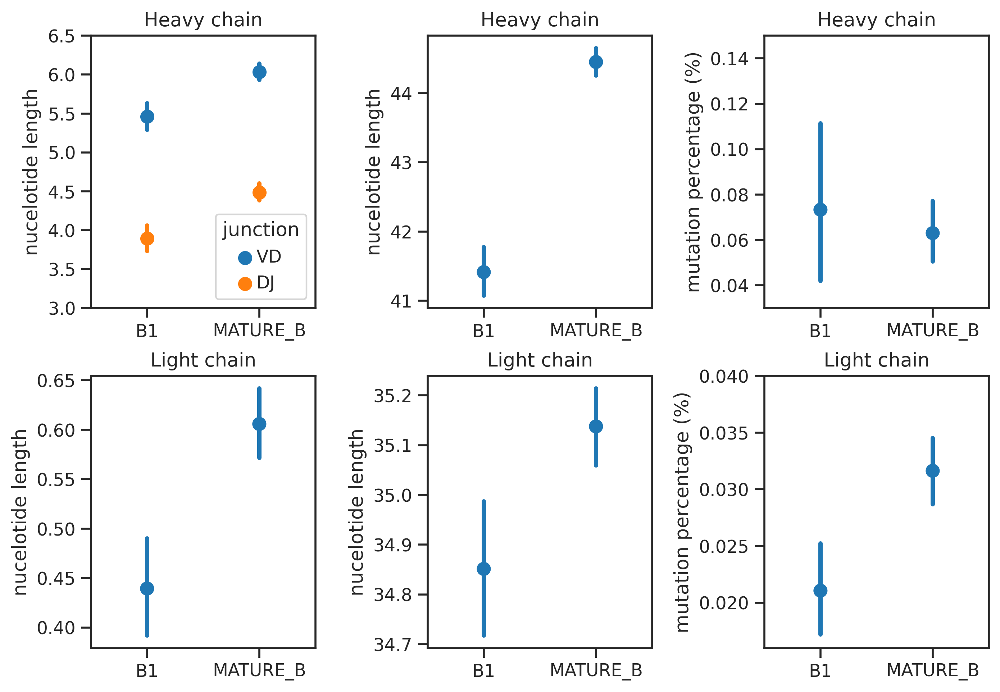

In [199]:
sb.set_theme(style="ticks")
fig, ax = plt.subplots(2,3,figsize=(10,7))
plt.subplots_adjust(wspace=0.5,hspace=0.25)

sb.pointplot(data=tb_sub, y='nucleotide length', x="celltype",hue='junction',ax=ax[0,0],palette='tab10',join=False)
ax[0,0].set_title('Heavy chain')
ax[0,0].set_ylabel('nucelotide length') 
ax[0,0].set_xlabel('') 
ax[0,0].set_ylim(3,6.5)

sb.pointplot(data=tb, y=tb.columns[3], x="anno_lvl_2_final_clean",ax=ax[1,0],ylabels=False,color=sb.color_palette('tab10')[0],join=False)
ax[1,0].set_title('Light chain')
ax[1,0].set_ylabel('nucelotide length') 
ax[1,0].set_xlabel('') 

sb.pointplot(data=tb, y=tb.columns[4], x="anno_lvl_2_final_clean",ax=ax[0,1],ylabels=False,color=sb.color_palette('tab10')[0],join=False)
ax[0,1].set_title('Heavy chain')
ax[0,1].set_ylabel('nucelotide length') 
ax[0,1].set_xlabel('')

sb.pointplot(data=tb, y=tb.columns[5], x="anno_lvl_2_final_clean",ax=ax[1,1],ylabels=False,color=sb.color_palette('tab10')[0],join=False)
ax[1,1].set_title('Light chain')
ax[1,1].set_ylabel('nucelotide length') 
ax[1,1].set_xlabel('')

sb.pointplot(data=tb, y=tb.columns[6], x="anno_lvl_2_final_clean",ax=ax[0,2],ylabels=False,color=sb.color_palette('tab10')[0],join=False)
ax[0,2].set_title('Heavy chain')
ax[0,2].set_ylabel('mutation percentage (%)') 
ax[0,2].set_xlabel('')
ax[0,2].set_ylim(0.03, 0.15)

sb.pointplot(data=tb, y=tb.columns[7], x="anno_lvl_2_final_clean",ax=ax[1,2],ylabels=False,color=sb.color_palette('tab10')[0],join=False)
ax[1,2].set_title('Light chain')
ax[1,2].set_ylabel('mutation percentage (%)') 
ax[1,2].set_xlabel('')
ax[1,2].set_ylim(0.016, 0.04)

plt.savefig(fig_path+'N_addition_raw_1.pdf',bbox_inches='tight')

### student t-test

In [761]:
matureb = list(tb['anno_lvl_2_final_clean']=='MATURE_B')
b1 = list(tb['anno_lvl_2_final_clean']=='B1')

In [762]:
sig = pd.DataFrame(columns = ['t_stats','pval','adj_pval'], index = tb.columns[1:])
for variable in sig.index: 
    matureb_list = tb.loc[matureb,variable]
    mask1 = ~(matureb_list.isna())
    b1_list = tb.loc[b1,variable]
    mask2 = ~(b1_list.isna())
    
    sig.loc[variable,'t_stats'], sig.loc[variable,'pval']=sp.stats.ttest_ind(matureb_list[mask1], b1_list[mask2])

In [763]:
sig.loc[:,'adj_pval']=stats.p_adjust(FloatVector(sig.loc[:,'pval']), method = 'BH')

In [764]:
sig

,t_stats,pval,adj_pval
NP-add_len_VD,5.34821,9.07913e-08,2.426697e-07
NP-add_len_DJ,5.32383,1.04001e-07,2.426697e-07
NP-add_len_VJ,4.59391,4.40344e-06,7.706020e-06
CDR3_junction_len_VDJ,15.0993,5.97048e-51,4.179333e-50
CDR3_junction_len_VJ,3.6596,0.00025391,2.962286e-04
mu_freq_VDJ,-0.630155,0.528608,5.286076e-01
mu_freq_VJ,3.69487,0.000221177,2.962286e-04


## % cells that have mutated vdj

In [765]:
df_mu = pd.DataFrame(index=bdata.obs['anno_lvl_2_final_clean'].cat.categories, columns=['mutated_vdj','germline_vdj',
                                                                                        'mutated_vj','germline_vj',
                                                                                        'mutated_vdj/vj','germline_vdj/vj',
                                                                                       'total'])
for cell in df_mu.index:
    df_mu.loc[cell,'total'] = sum(bdata.obs['anno_lvl_2_final_clean']==cell)
    df_mu.loc[cell,'germline_vdj'] = sum(bdata.obs.loc[bdata.obs['anno_lvl_2_final_clean']==cell,'mu_count_VDJ']==0)
    df_mu.loc[cell,'germline_vj'] = sum(bdata.obs.loc[bdata.obs['anno_lvl_2_final_clean']==cell,'mu_count_VJ']==0)
    df_mu.loc[cell,'germline_vdj/vj'] = sum(bdata.obs.loc[bdata.obs['anno_lvl_2_final_clean']==cell,'mu_count']==0)
    
    df_mu.loc[cell,'mutated_vdj'] = df_mu.loc[cell,'total'] - df_mu.loc[cell,'germline_vdj']
    df_mu.loc[cell,'mutated_vj'] = df_mu.loc[cell,'total'] - df_mu.loc[cell,'germline_vj']
    df_mu.loc[cell,'mutated_vdj/vj'] = df_mu.loc[cell,'total'] - df_mu.loc[cell,'germline_vdj/vj']

In [766]:
df_mu

,mutated_vdj,germline_vdj,mutated_vj,germline_vj,mutated_vdj/vj,germline_vdj/vj,total
B1,135,2257,126,2266,254,2138,2392
CYCLING_B,40,702,58,684,93,649,742
IMMATURE_B,61,891,64,888,120,832,952
MATURE_B,420,7171,564,7027,944,6647,7591
PLASMA_B,2,20,1,21,3,19,22


In [767]:
df_mu_perc = df_mu.copy()
df_mu_perc.iloc[:,range(6)] = df_mu.iloc[:,range(6)]/np.reshape(np.array(df_mu.iloc[:,6]),(5,1)) *100

In [768]:
df_mu_perc

,mutated_vdj,germline_vdj,mutated_vj,germline_vj,mutated_vdj/vj,germline_vdj/vj,total
B1,5.64381,94.3562,5.26756,94.7324,10.6187,89.3813,2392
CYCLING_B,5.39084,94.6092,7.81671,92.1833,12.5337,87.4663,742
IMMATURE_B,6.40756,93.5924,6.72269,93.2773,12.605,87.395,952
MATURE_B,5.53287,94.4671,7.42985,92.5701,12.4358,87.5642,7591
PLASMA_B,9.09091,90.9091,4.54545,95.4545,13.6364,86.3636,22


In [769]:
tmp = df_mu_perc.loc[['B1','MATURE_B'],['mutated_vdj','mutated_vj','mutated_vdj/vj']]

In [770]:
tmp

,mutated_vdj,mutated_vj,mutated_vdj/vj
B1,5.64381,5.26756,10.6187
MATURE_B,5.53287,7.42985,12.4358


In [771]:
df_mu_plot = pd.DataFrame(columns=['% cells that have non-germline v(d)j','chain type','cell type'])
df_mu_plot.loc[:,'% cells that have non-germline v(d)j'] = np.array(tmp).flatten()
df_mu_plot.loc[:,'chain type'] = list(tmp.columns) *2
df_mu_plot.loc[:,'cell type'] = ['B1'] *3 +['MATURE_B']*3

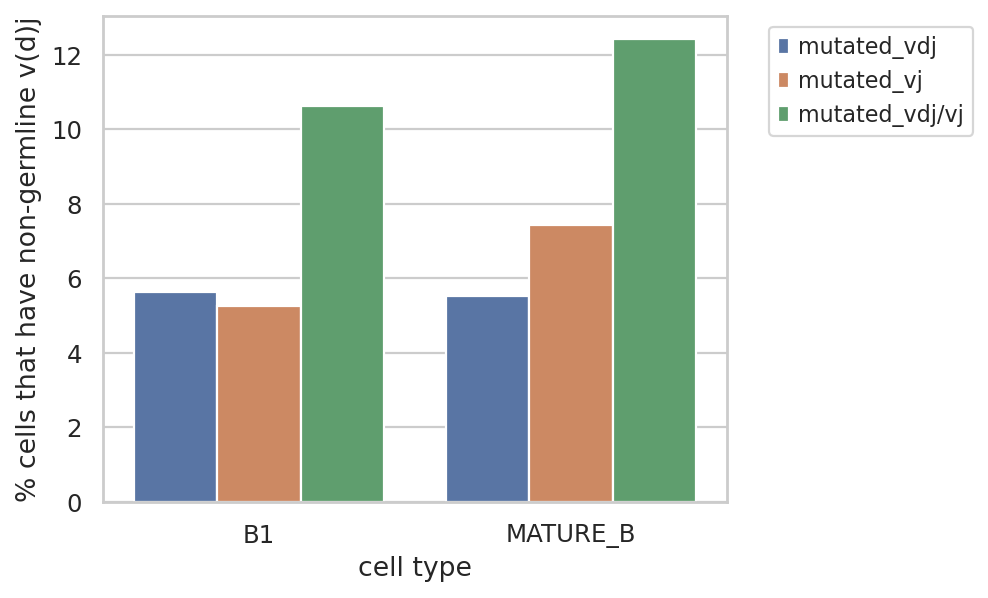

In [772]:

ax = sb.barplot(x="cell type", y="% cells that have non-germline v(d)j", hue="chain type", data=df_mu_plot)
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')
plt.savefig('figures/BCR_mu.png',bbox_inches='tight')

### chi-square significance test

In [773]:
mu_cs = df_mu.iloc[[0,3],:-1].copy()

In [774]:
mu_cs

,mutated_vdj,germline_vdj,mutated_vj,germline_vj,mutated_vdj/vj,germline_vdj/vj
B1,135,2257,126,2266,254,2138
MATURE_B,420,7171,564,7027,944,6647


In [775]:
sig = pd.DataFrame(columns=['OR','pval'],index = ['vdj','vj','vdj/vj'])

In [776]:
for chain in sig.index:
    observed = mu_cs.loc[:,['mutated_'+chain,'germline_'+chain]]
    
    sig.loc[chain,'OR'] = (observed.iloc[0,0] / observed.iloc[0,1]) / (observed.iloc[1,0] / observed.iloc[1,1])
    _, sig.loc[chain,'pval'], _, _ = sp.stats.chi2_contingency(observed=observed)

In [777]:
sig

,OR,pval
vdj,1.02125,0.876561
vj,0.69279,0.000331503
vdj/vj,0.836526,0.0188445


## IGK vs IGL usage

In [779]:
df = bdata.obs.loc[:,['anno_lvl_2_final_clean','locus_VJ']]

In [781]:
df2 = df.groupby(['anno_lvl_2_final_clean','locus_VJ']).size()

In [792]:
df2

anno_lvl_2_final_clean  locus_VJ
B1                      IGK         1308
                        IGL         1084
CYCLING_B               IGK          438
                        IGL          304
IMMATURE_B              IGK          526
                        IGL          426
MATURE_B                IGK         4272
                        IGL         3319
PLASMA_B                IGK           12
                        IGL           10
dtype: int64

In [789]:
observed.iloc[0,0] = df2[0]
observed.iloc[0,1] = df2[1]
observed.iloc[1,0] = df2[6]
observed.iloc[1,1] = df2[7]

In [790]:
observed

,mutated_vdj/vj,germline_vdj/vj
B1,1308,1084
MATURE_B,4272,3319


In [793]:
_, pval, _, _ = sp.stats.chi2_contingency(observed=observed)

In [794]:
pval # no difference in IGK, IGL usage

0.17819686500736903

## VDJ usage difference

In [795]:
#cdata = bdata[bdata.obs['anno_lvl_2_final_clean'].isin(['MATURE_B','B1'])].copy()

In [189]:
cdata = adata_bcr[adata_bcr.obs['anno_lvl_2_final_clean'].isin(['PRO_B','LATE_PRO_B','LARGE_PRE_B','SMALL_PRE_B','IMMATURE_B','MATURE_B','B1',
                                                               'CYCLING_B'])].copy()

In [194]:
cdata.obs['anno_lvl_2_final_clean'] = cdata.obs['anno_lvl_2_final_clean'].cat.reorder_categories(['PRO_B','LATE_PRO_B','LARGE_PRE_B','SMALL_PRE_B','IMMATURE_B','MATURE_B','B1',
                                                               'CYCLING_B'])

housekeeping - for cells with IgM/IgD, they might have two chains called for each, choose the first one

In [195]:
tmp = cdata.obs.loc[cdata.obs['isotype_summary']=='IgD|IgM',['v_call_genotyped_VJ','j_call_VJ','v_call_genotyped_VDJ','d_call_VDJ','j_call_VDJ']]

In [196]:
tmp.shape

(95, 5)

In [197]:
cdata.obs['v_call_genotyped_VJ'] = cdata.obs['v_call_genotyped_VJ'].astype('str')
cdata.obs['j_call_VJ'] = cdata.obs['j_call_VJ'].astype('str')
cdata.obs['v_call_genotyped_VDJ'] = cdata.obs['v_call_genotyped_VDJ'].astype('str')
cdata.obs['d_call_VDJ'] = cdata.obs['d_call_VDJ'].astype('str')
cdata.obs['j_call_VDJ'] = cdata.obs['j_call_VDJ'].astype('str')

In [199]:
cdata.obs.loc[cdata.obs['isotype_summary']=='IgD|IgM',['v_call_genotyped_VJ','j_call_VJ','v_call_genotyped_VDJ','d_call_VDJ','j_call_VDJ']] = np.array([chain.split('|')[0] for chain in np.array(tmp).flatten()]).reshape(95,5)

In [200]:
Counter(cdata.obs['d_call_VDJ']) # many can't be accurately called, with 1495 nan

Counter({'IGHD1-20|IGHD1-7|IGHD1-1': 309,
         'nan': 1495,
         'IGHD7-27': 6663,
         'IGHD2-8': 246,
         'IGHD2-21': 475,
         'IGHD1-26': 437,
         'IGHD1-20|IGHD1-7|IGHD1/OR15-1a': 256,
         'IGHD2/OR15-2a|IGHD2/OR15-2b': 108,
         'IGHD3-10': 882,
         'IGHD1-20|IGHD1-1|IGHD1-14': 28,
         'IGHD2-2|IGHD1-14': 13,
         'IGHD7-27|IGHD1-26': 48,
         'IGHD7-27|IGHD1-1': 119,
         'IGHD5-24': 131,
         'IGHD6-6': 783,
         'IGHD2-2': 409,
         'IGHD3-3': 409,
         'IGHD5-12': 194,
         'IGHD3-16|IGHD3-10': 446,
         'IGHD1-14': 196,
         'IGHD4-23': 135,
         'IGHD6-25': 61,
         'IGHD2-21|IGHD2-15': 83,
         'IGHD6-19': 374,
         'IGHD3-16|IGHD6-19': 39,
         'IGHD3-16': 958,
         'IGHD4-17|IGHD3-10': 5,
         'IGHD3-16|IGHD4/OR15-4a': 7,
         'IGHD2/OR15-2a|IGHD2/OR15-2b|IGHD3-10': 23,
         'IGHD6-13|IGHD6-19|IGHD4-23': 3,
         'IGHD3-16|IGHD3/OR15-3a': 24,
      

In [201]:
#write csv for logistic regression
cdata.obs.to_csv('csv/BCR_VDJ_usage.csv') 

In [202]:
cdata.obs['v_call_genotyped_VJ'] = cdata.obs['v_call_genotyped_VJ'].astype('category')
cdata.obs['j_call_VJ'] = cdata.obs['j_call_VJ'].astype('category')
cdata.obs['v_call_genotyped_VDJ'] = cdata.obs['v_call_genotyped_VDJ'].astype('category')
cdata.obs['d_call_VDJ'] = cdata.obs['d_call_VDJ'].astype('category')
cdata.obs['j_call_VDJ'] = cdata.obs['j_call_VDJ'].astype('category')

In [203]:
# check all genes from adata are inside (don't take IGHD)
IGLV_list = list(cdata.obs['v_call_genotyped_VJ'].cat.categories)
IGLJ_list = list(cdata.obs['j_call_VJ'].cat.categories)
IGHV_list = list(cdata.obs['v_call_genotyped_VDJ'].cat.categories)
IGHD_list = list(cdata.obs['d_call_VDJ'].cat.categories)
IGHJ_list = list(cdata.obs['j_call_VDJ'].cat.categories)
BCR_list = IGLV_list+IGLJ_list+IGHV_list+IGHJ_list

In [204]:
BCR_list =list(compress(BCR_list, pd.Series(BCR_list).str.startswith('IG')))
#BCR_list =[chain for chain in BCR_list if '|' not in chain]

In [205]:
BCR_list

['IGKV1-12',
 'IGKV1-16',
 'IGKV1-17',
 'IGKV1-27',
 'IGKV1-33',
 'IGKV1-33|IGKV1D-33',
 'IGKV1-37|IGKV1D-37',
 'IGKV1-39',
 'IGKV1-39|IGKV1D-39',
 'IGKV1-5',
 'IGKV1-6',
 'IGKV1-8',
 'IGKV1-9',
 'IGKV1-NL1',
 'IGKV1D-12',
 'IGKV1D-12|IGKV1-12',
 'IGKV1D-13',
 'IGKV1D-13|IGKV1-13',
 'IGKV1D-16',
 'IGKV1D-43',
 'IGKV1D-8',
 'IGKV2-18',
 'IGKV2-24',
 'IGKV2-28',
 'IGKV2-28|IGKV2D-28',
 'IGKV2-29',
 'IGKV2-30',
 'IGKV2D-24',
 'IGKV2D-26',
 'IGKV2D-29',
 'IGKV2D-30',
 'IGKV2D-40',
 'IGKV2D-40|IGKV2-40',
 'IGKV3-11',
 'IGKV3-15',
 'IGKV3-20',
 'IGKV3-7',
 'IGKV3D-11',
 'IGKV3D-15',
 'IGKV3D-20',
 'IGKV3D-7|IGKV3/OR2-268',
 'IGKV4-1',
 'IGKV5-2',
 'IGKV6-21',
 'IGKV6D-21',
 'IGKV6D-21|IGKV6-21',
 'IGKV6D-41',
 'IGKV7-3',
 'IGLV1-36',
 'IGLV1-36|IGLV1-44',
 'IGLV1-40',
 'IGLV1-41',
 'IGLV1-44',
 'IGLV1-47',
 'IGLV1-51',
 'IGLV10-54',
 'IGLV2-11',
 'IGLV2-14',
 'IGLV2-18',
 'IGLV2-23',
 'IGLV2-5|IGLV2-18',
 'IGLV2-8',
 'IGLV3-1',
 'IGLV3-10',
 'IGLV3-12',
 'IGLV3-13',
 'IGLV3-16',
 'IGLV3-19',

### plot heatmap of gene usage

In [268]:
BCR = pd.DataFrame(columns = list(compress(BCR_list, pd.Series(BCR_list).str.startswith(('IGHJ')))),  index = ['PRO_B','LATE_PRO_B','LARGE_PRE_B','SMALL_PRE_B',
                                                                                                               'IMMATURE_B','MATURE_B','B1','CYCLING_B'])

In [269]:
for i in range(BCR.shape[0]):
    cell = BCR.index[i]
    counter = Counter(cdata.obs.loc[cdata.obs['anno_lvl_2_final_clean']==cell,'j_call_VDJ'])
    for BCRtype in BCR.columns:
        BCR.loc[cell,BCRtype] = counter[BCRtype]
    
    
    BCR.loc[cell,:] = BCR.loc[cell,:] / np.sum(BCR.loc[cell,:]) * 100

In [252]:
np.sum(BCR,axis=1)

LARGE_PRE_B     320.0
SMALL_PRE_B    2015.0
IMMATURE_B      952.0
MATURE_B       7591.0
B1             2392.0
CYCLING_B       742.0
dtype: float64

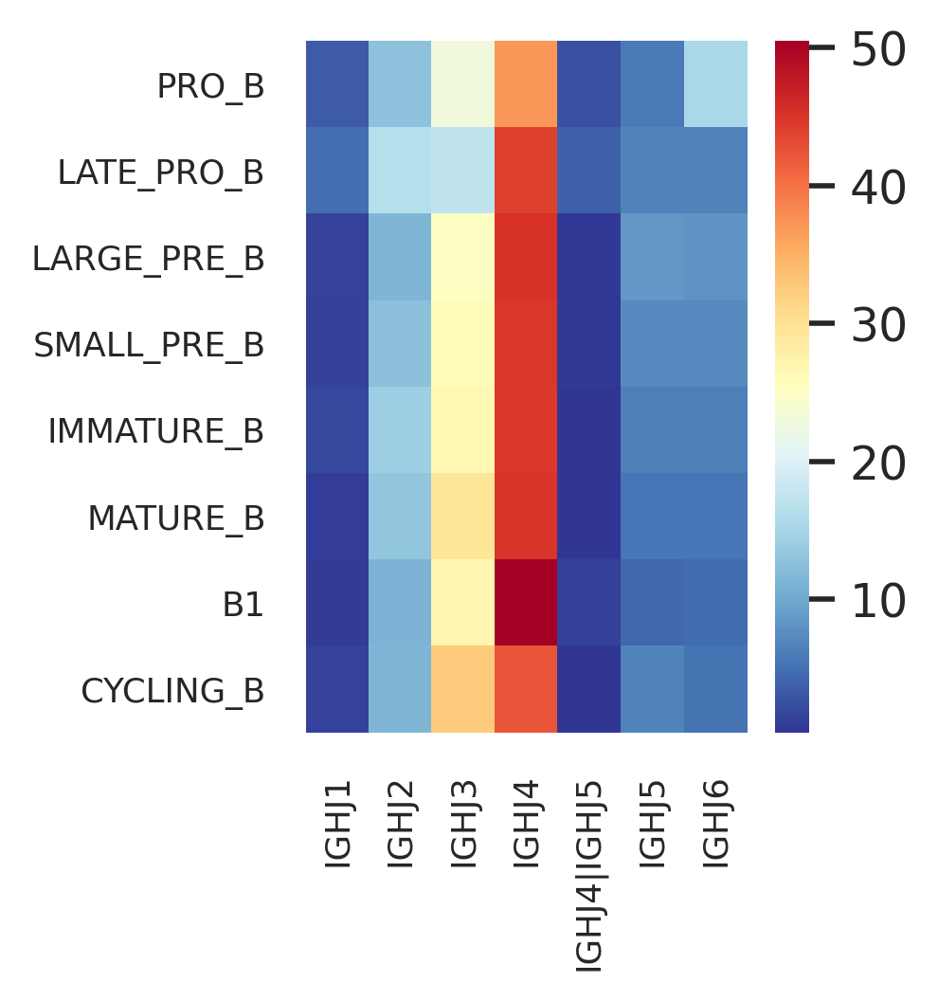

In [270]:
#np.random.seed(0)
fig, ax = plt.subplots(figsize=(BCR.shape[1]/3,BCR.shape[0]*0.375))
#sb.set_theme()
uniform_data = BCR
uniform_data=uniform_data.astype('float')
ax = sb.heatmap(uniform_data,cmap='RdYlBu_r')
_, xlabels = plt.xticks()
_, ylabels = plt.yticks()
ax.set_xticklabels(xlabels, size=8,rotation=90)
ax.set_yticklabels(ylabels, size=8,rotation=0)
plt.savefig('figures/BCR_IGHJ.png',bbox_inches='tight');

## Chi-square test

In [278]:
BCR_gene = ['v_call_genotyped_VJ','j_call_VJ','v_call_genotyped_VDJ','j_call_VDJ']
b1_tot = Counter(cdata.obs['anno_lvl_2_final_clean'])['B1']
matureb_tot = Counter(cdata.obs['anno_lvl_2_final_clean'])['MATURE_B']
chisq_result = pd.DataFrame(columns=['OR','LFC','pval','adj_pval'],index = BCR_list)

for chain in BCR_gene:
    df = cdata.obs.loc[:,['anno_lvl_2_final_clean',chain]]
    for gene in cdata.obs[chain].cat.categories:
        
        counter = Counter(df.loc[df[chain]==gene,'anno_lvl_2_final_clean'])
        observed = np.array([[counter['B1'],b1_tot-counter['B1']],
                    [counter['MATURE_B'],matureb_tot-counter['MATURE_B']]])
        
        chisq_result.loc[gene,'OR'] = (observed[0,0]/observed[0,1]) / (observed[1,0]/observed[1,1])
        chisq_result.loc[gene,'LFC'] = np.log2((observed[0,0]/(observed[0,0]+observed[0,1])) / (observed[1,0]/(observed[1,0]+observed[1,1])))
        try:
            _, chisq_result.loc[gene,'pval'], _, _ = sp.stats.chi2_contingency(observed=observed)
        except ValueError:
            chisq_result.loc[gene,'pval'] = 1

<ipython-input-278-747d8072acb2>:15: RuntimeWarning: divide by zero encountered in log2
  chisq_result.loc[gene,'LFC'] = np.log2((observed[0,0]/(observed[0,0]+observed[0,1])) / (observed[1,0]/(observed[1,0]+observed[1,1])))
<ipython-input-278-747d8072acb2>:14: RuntimeWarning: invalid value encountered in double_scalars
  chisq_result.loc[gene,'OR'] = (observed[0,0]/observed[0,1]) / (observed[1,0]/observed[1,1])
<ipython-input-278-747d8072acb2>:15: RuntimeWarning: invalid value encountered in double_scalars
  chisq_result.loc[gene,'LFC'] = np.log2((observed[0,0]/(observed[0,0]+observed[0,1])) / (observed[1,0]/(observed[1,0]+observed[1,1])))
<ipython-input-278-747d8072acb2>:14: RuntimeWarning: divide by zero encountered in double_scalars
  chisq_result.loc[gene,'OR'] = (observed[0,0]/observed[0,1]) / (observed[1,0]/observed[1,1])
<ipython-input-278-747d8072acb2>:15: RuntimeWarning: divide by zero encountered in double_scalars
  chisq_result.loc[gene,'LFC'] = np.log2((observed[0,0]/(obser

In [284]:
chisq_result.loc[:,'adj_pval']=stats.p_adjust(FloatVector(chisq_result.loc[:,'pval']), method = 'BH')

In [285]:
chisq_result.to_csv('csv/bcr_chisq.csv')

In [286]:
a =list(chisq_result.loc[:,'adj_pval']<0.05)
chisq_result.loc[a,:]

,OR,LFC,pval,adj_pval
IGKV1-17,0.609443,-0.700329,0.00731615,3.960814e-02
IGKV1-33|IGKV1D-33,0.401197,-1.2841,8.31951e-08,1.865947e-06
IGKV1-39|IGKV1D-39,1.44787,0.478699,6.98691e-07,1.096944e-05
IGKV1-8,1.75395,0.789902,7.58016e-05,6.263603e-04
IGKV2-30,1.49448,0.562529,0.00292366,1.820283e-02
IGKV3-15,0.646367,-0.61331,0.00633892,3.554325e-02
IGKV3-20,0.630445,-0.616969,1.41793e-06,2.023778e-05
IGKV4-1,1.76065,0.762164,2.6531e-10,1.388456e-08
IGLV1-47,2.17677,1.08718,6.05893e-10,2.378128e-08
IGLV2-14,0.541155,-0.843918,3.19815e-07,5.578993e-06


### BCR clonal expansion

In [47]:
bdata.obs["anno_lvl_2_final_clean"] = bdata.obs["anno_lvl_2_final_clean"].cat.reorder_categories(['IMMATURE_B','MATURE_B','B1','CYCLING_B','PLASMA_B'])

In [48]:
#bdata.obs['clonotype_size']=bdata.obs['clone_id_size']
bdata.obs['clonotype'] = bdata.obs['clone_id']

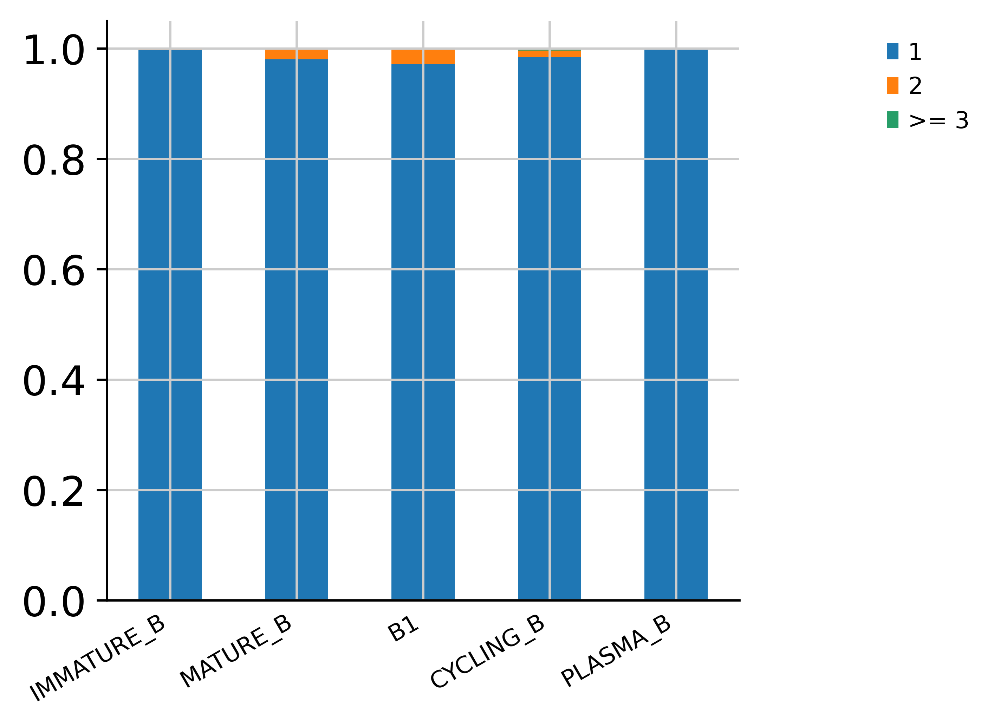

In [49]:
ir.pl.clonal_expansion(bdata, "anno_lvl_2_final_clean",fig_kws={'figsize': (5, 5), 'dpi': 300})
plt.savefig(fig_path+"BCR_clonal_size.pdf",bbox_inches='tight')

use chisq to calculate significance for clonal expansion

In [59]:
tbl_ce = pd.DataFrame(index = ['clonotype size =1','clonotype size >1'],
                     columns = bdata.obs['anno_lvl_2_final_clean'].cat.categories)
for cell in tbl_ce.columns:
    c = Counter(bdata[bdata.obs['anno_lvl_2_final_clean']==cell].obs['clonotype'])
    df = pd.DataFrame.from_dict(c, orient='index').reset_index()
    tbl_ce.loc['clonotype size =1',cell] = Counter(df[0])[1]
    tbl_ce.loc['clonotype size >1',cell] = sum(bdata.obs['anno_lvl_2_final_clean']==cell) - Counter(df[0])[1]

In [60]:
tbl_ce

,IMMATURE_B,MATURE_B,B1,CYCLING_B,PLASMA_B
clonotype size =1,950,7448,2335,731,22
clonotype size >1,2,143,57,11,0


In [61]:
# % cells that are of clonotype size >1
tbl_ce.loc['clonotype size >1'] / tbl_ce.loc['clonotype size =1'] * 100 

IMMATURE_B    0.210526
MATURE_B       1.91998
B1             2.44111
CYCLING_B      1.50479
PLASMA_B             0
dtype: object

In [62]:
# compare B1 and mature_B with chi-sq
observed = tbl_ce.loc[:,['MATURE_B','B1']]
_, pval, _, _ = sp.stats.chi2_contingency(observed=observed)
print(pval)
# conclusion: no significant difference 

0.1511255113666583


# ELISPOT results

In [131]:
eli = pd.read_csv('csv/ELISPOT_07082021_result.csv')

In [132]:
eli = eli.loc[~eli['well'].isin(['G3','G4','G5','G6']),:]

In [133]:
eli['frequency of antibody secreting spot'] = eli['spot_no'] / eli['cell_no'] *100
eli['spot_surface normalised by cell_no'] = eli['spot_surface'] / eli['cell_no']

In [134]:
for donor in ['F144','F145']:
    donorls = eli['donor']==donor
    select = (eli['donor']==donor) & (eli['sort_fraction']=='CCR10hi')
    mean_CCR10_ct = np.mean(eli.loc[select,'frequency of antibody secreting spot'])
    mean_CCR10_area = np.mean(eli.loc[select,'spot_surface normalised by cell_no'])
    
    eli.loc[donorls, 'normalised_spot_count'] = eli.loc[donorls, 'frequency of antibody secreting spot'] / mean_CCR10_ct *100
    eli.loc[donorls, 'normalised_spot_area'] = eli.loc[donorls, 'spot_surface normalised by cell_no'] / mean_CCR10_ct *100

In [135]:
eli

,well,spot_no,spot_surface,donor,sort_fraction,cell_no,frequency of antibody secreting spot,spot_surface normalised by cell_no,normalised_spot_count,normalised_spot_area
0,E3,238,2.453,F144,CCR10hi,7000,3.400000,0.000350,101.927195,0.010505
1,E4,229,2.419,F144,CCR10hi,7000,3.271429,0.000346,98.072805,0.010360
2,E5,169,1.769,F144,CCR10loCD27+CD43+,7000,2.414286,0.000253,72.376874,0.007576
3,E6,166,1.951,F144,CCR10loCD27+CD43+,7000,2.371429,0.000279,71.092077,0.008355
4,E7,80,0.895,F144,CCR10loCD27-CD43+,7000,1.142857,0.000128,34.261242,0.003833
5,E8,54,0.710,F144,CCR10loCD27-CD43+,7000,0.771429,0.000101,23.126338,0.003041
6,F3,32,0.327,F145,CCR10hi,7000,0.457143,0.000047,103.225806,0.010548
7,F4,30,0.383,F145,CCR10hi,7000,0.428571,0.000055,96.774194,0.012355
8,F5,22,0.267,F145,CCR10loCD27+CD43+,7000,0.314286,0.000038,70.967742,0.008613
9,F6,22,0.260,F145,CCR10loCD27+CD43+,7000,0.314286,0.000037,70.967742,0.008387


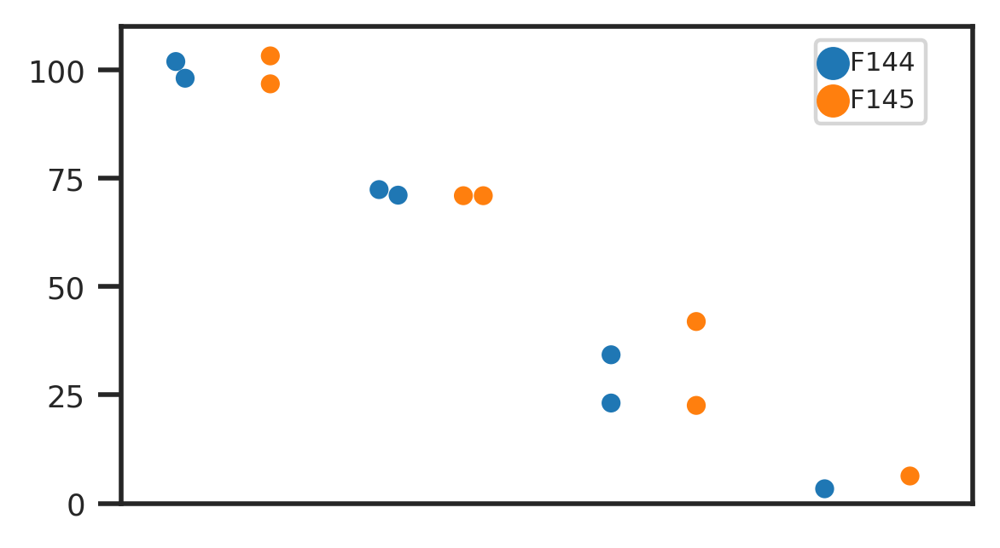

In [138]:
sb.set_style("ticks")
fig, ax = plt.subplots(figsize=(4,2.3))
s = sb.swarmplot(eli.loc[:,'sort_fraction'], eli.loc[:,'normalised_spot_count'], size=5,hue=eli.loc[:,'donor'],palette='tab10',dodge=True)

#g = sb.lineplot(data=eli, x='sort_fraction', y='normalised_spot_count', hue='donor')
s.legend(bbox_to_anchor=(0.8, 1), loc='upper left', fontsize='x-small')
s.set(ylabel='',xlabel='')
s.set(ylim=(0, 110))

#remove x ticks and tick labels
s.set(xticklabels=[])
s.tick_params(bottom=False)

#plt.xticks(fontsize=5)
plt.yticks(fontsize=8)
plt.savefig(fig_path+'elispot.pdf',bbox_inches='tight')

(array([-0.0001,  0.    ,  0.0001,  0.0002,  0.0003,  0.0004]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

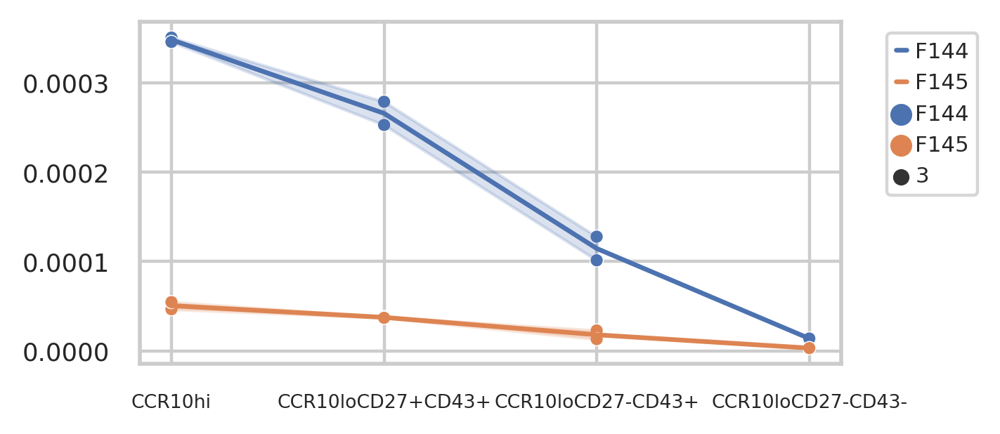

In [137]:
sb.set_style("whitegrid")
fig, ax = plt.subplots(figsize=(4,2))
s = sb.scatterplot(eli.loc[:,'sort_fraction'], eli.loc[:,'spot_surface normalised by cell_no'], size=3,hue=eli.loc[:,'donor'])

g = sb.lineplot(data=eli, x='sort_fraction', y='spot_surface normalised by cell_no', hue='donor')
s.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='x-small')
s.set(ylabel='',xlabel='')
plt.xticks(fontsize=6)
plt.yticks(fontsize=8)
#plt.savefig('figures/elispot.svg',bbox_inches='tight')